# Import packages

In [1]:
import numpy as np
import scanpy as sc
import seaborn as sns
import pandas as pd
import re
from anndata import AnnData
import decoupler as dc
from scipy.stats import ttest_ind

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as patches
%matplotlib inline

sc.settings.verbosity = 0
sc.settings.set_figure_params(
    dpi=200,
    facecolor="white",
    frameon=False,
)

# Define functions

In [2]:
def patch_plot(patches, ax=None, order='sort', w=0.25, h=0, legend_right=True,
               show_ticks=False):
    cur_patches = pd.Series(patches)

    if order == 'sort':
        order = list(np.sort(cur_patches.index))

    data = pd.Series([1] * len(order), index=order[::-1])
    if ax is None:
        if h == 0:
            h = 0.3 * len(patches)
        _, ax = plt.subplots(figsize=(w, h))

    data.plot(kind='barh', color=[cur_patches[x] for x in data.index], width=1, ax=ax)
    ax.set_xticks([])
    if legend_right:
        ax.yaxis.tick_right()

    sns.despine(offset={'left': -2}, ax=ax)

    ax.grid(False)
    for spine in ax.spines.values():
        spine.set_visible(False)

    if not show_ticks:
        ax.tick_params(length=0)

    return ax

In [3]:
def plot_stacked_bar_custom_palette(df, cell_type, palette,
                                    status_colors, patient_order, target_column):
    if cell_type == 'Immune':
        df_filtered = df[df['cell_type'] == 'Immune']
    elif cell_type == 'Fibro':
        df_filtered = df[df['cell_type'] == 'Fibro']
    elif cell_type == 'TME':
        df_filtered = df[df['cell_type'].isin(['Immune', 'Stromal'])]
    else:
        df_filtered = df
    print(df_filtered.shape)
        
    pivot_df = df_filtered.pivot(index='patient_id',
                                 columns=target_column,
                                 values='proportion').fillna(0)

    pat_order = patient_order
    pivot_df = pivot_df.loc[pat_order]
    
    fig, ax = plt.subplots(figsize=(12, 6))
    
    pivot_df.plot(kind='bar', stacked=True,
                  color=[color_mapping[sub] for sub in pivot_df.columns],
                  ax=ax)

    ax.set_title(f'Stacked Proportions of {cell_type} Cell Subtypes per Patient with Annotations')
    ax.set_ylabel('Proportion')
    ax.set_xlabel('Patient ID')
    ax.legend(title='Cell Subtype', bbox_to_anchor=(1.05, 1), loc='upper left')
    ax.set_xticklabels([convertion_EOC_back[x] for x in patient_order],
                   rotation=0, fontsize=14)

    plt.tight_layout()
    plt.grid(False)

    return fig

# Palettes

In [4]:
color_mapping = {
    'B cells': '#33658A',
    'Plasma cells': '#669EC8',
    'T cells': '#68A691',
    'NK cells': '#176B27',
    'pDC': '#279AF1',
    'Macrophages+DC': '#F3B391',
    'Mast cells': '#ED5233',
    'Fibroblasts': '#9792E3',
    'EOC': '#3D405B',
    'Endothelial cells': '#C64191',
}

<Axes: >

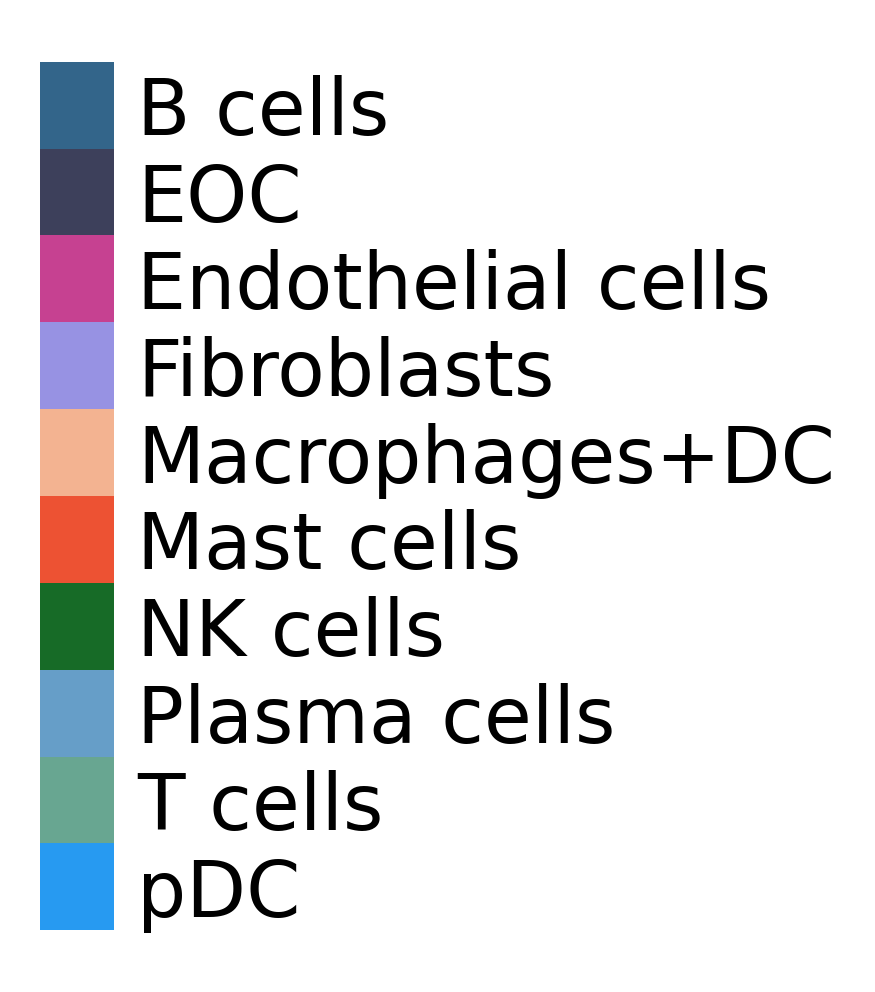

In [5]:
patch_plot(color_mapping)

In [6]:
patients_colors_EOC = {
    'EOC3': '#987284',
    'EOC87': '#EFA9AE',
    'EOC204': '#EBA889',
    'EOC115': '#BC4B51',
    'EOC372': '#5B8E7D',
    'EOC136': '#8A89C0',
    'EOC153': '#0081AF',
    'EOC227': '#90BEDE',
    'EOC649': '#A6D49F',
    'EOC1127': '#FFDF88'
}

<Axes: >

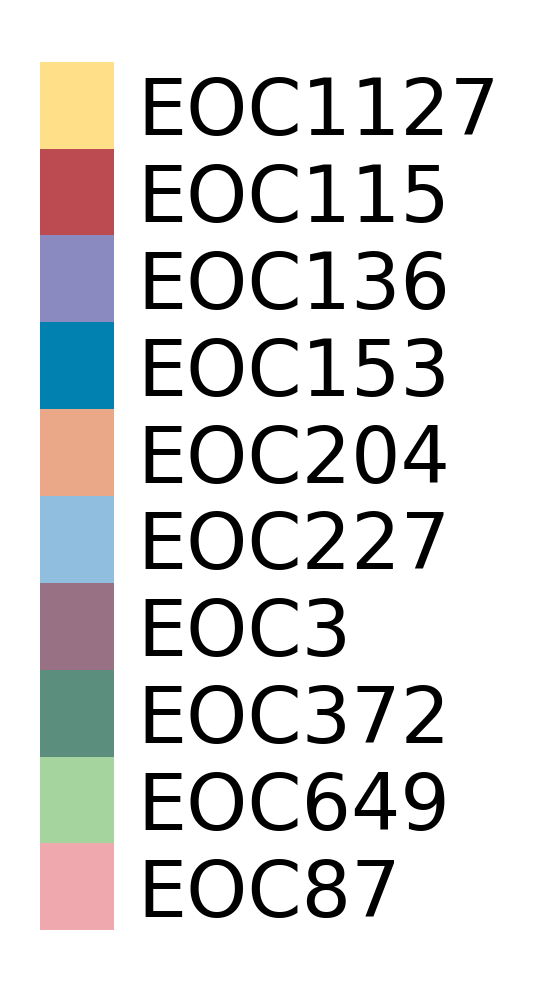

In [7]:
patch_plot(patients_colors_EOC)

In [8]:
color_mapping = {
    'EOC': '#F78764',
    'Immune': '#68A691',
    'Stromal': '#742792'
}

<Axes: >

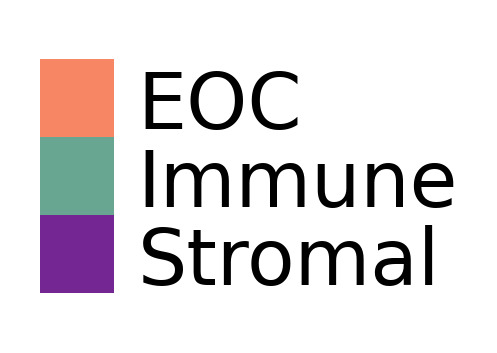

In [9]:
patch_plot(color_mapping)

In [10]:
HRD_palette = {
    'HRP': '#81A4CD',
    'HRD': '#FFA047'}

<Axes: >

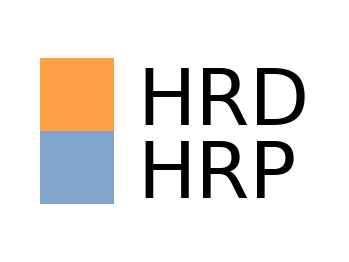

In [11]:
patch_plot(HRD_palette)

In [12]:
tissue_palette = {
    'Mesentary': '#6F9CEB',
    'Omentum': '#5B8C5A',
    'Peritoneum': '#7F2982'
}

<Axes: >

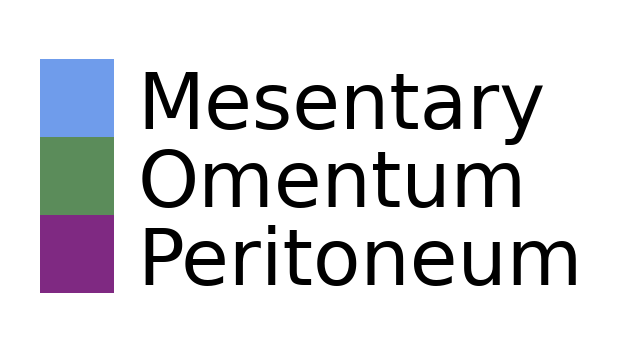

In [13]:
patch_plot(tissue_palette)

# Annotation

In [14]:
status_palette = {'Refractory': '#f28482',
                  'Responsive': '#81b29a',
                  'Intermediate': '#4280A7'
                 }

In [15]:
patients = [
    'EOC3', 'EOC87', 'EOC204', 'EOC115', # refractory
    'EOC1127', 'EOC153', 'EOC372', 'EOC227', 'EOC649', 'EOC136' # responsive
]

In [16]:
samples_ordered = ['EOC87_pPer', 'EOC3_pPer', 'EOC204_pMes', 'EOC115_pPer',
                   'EOC153_pOme', 'EOC136_pMes', 'EOC1127_pOme', 'EOC227_pOme', 'EOC649_pOme', 'EOC372_pPer']

patients_ordered = ['EOC87', 'EOC3', 'EOC204', 'EOC115',
                    'EOC153', 'EOC136', 'EOC1127', 'EOC227', 'EOC649', 'EOC372']

In [17]:
mymeta = pd.read_csv('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/meta_patients.tsv',
            sep='\t', index_col=0)
mymeta.index = mymeta['publication_code']
mymeta.index.name = ''
mymeta['Definition'] = mymeta['Status'].replace({'Refractory': 'R',
                                                 'Responsive': 'S'})
mymeta.head(3)

,scRNA_sample,publication_code,Status,SBS3,tissue,Definition
,,,,,,
EOC3,EOC3_pPer,EOC3,Refractory,HRP,Peritoneum,R
EOC87,EOC87_pPer,EOC87,Refractory,HRP,Peritoneum,R
EOC204,EOC204_pMes,EOC204,Refractory,HRD,Mesentary,R


In [18]:
mymeta

,scRNA_sample,publication_code,Status,SBS3,tissue,Definition
,,,,,,
EOC3,EOC3_pPer,EOC3,Refractory,HRP,Peritoneum,R
EOC87,EOC87_pPer,EOC87,Refractory,HRP,Peritoneum,R
EOC204,EOC204_pMes,EOC204,Refractory,HRD,Mesentary,R
EOC115,EOC115_pPer,EOC115,Refractory,HRP,Peritoneum,R
EOC372,EOC372_pPer,EOC372,Responsive,HRD,Peritoneum,S
EOC136,EOC136_pMes,EOC136,Responsive,HRD,Mesentary,S
EOC153,EOC153_pOme,EOC153,Responsive,HRD,Omentum,S
EOC227,EOC227_pOme,EOC227,Responsive,HRP,Omentum,S
EOC649,EOC649_pOme,EOC649,Responsive,HRP,Omentum,S


In [19]:
meta = pd.read_csv('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/meta.tsv',
            sep='\t', index_col=0)

In [20]:
meta['orig.ident'].value_counts()

EOC3_pPer       3154
EOC204_pMes     2587
EOC136_pMes     2506
EOC227_pOme     2179
EOC115_pPer     2105
EOC87_pPer      1526
EOC1127_pOme    1193
EOC372_pPer      712
EOC649_pOme      490
EOC153_pOme      330
Name: orig.ident, dtype: int64

In [21]:
meta.head(5)

,orig.ident,nFeature_RNA,nCount_RNA,nReads_RNA,percent.mt,cell_type,patient,Status,SBS3,tissue,phase,cell_id
AACACGTAGTTAAGTG-EOC649_pOme,EOC649_pOme,9354,129922,2110719,10.517079,EOC,EOC649,Responsive,HRP,Omentum,Primary,AACACGTAGTTAAGTG-EOC649_pOme
AACGTTGGTTTGTGTG-EOC649_pOme,EOC649_pOme,6051,49375,789956,8.380759,EOC,EOC649,Responsive,HRP,Omentum,Primary,AACGTTGGTTTGTGTG-EOC649_pOme
AAGGTTCAGGGTGTTG-EOC649_pOme,EOC649_pOme,9118,106095,1644151,5.466799,EOC,EOC649,Responsive,HRP,Omentum,Primary,AAGGTTCAGGGTGTTG-EOC649_pOme
ACATCAGGTTGAACTC-EOC649_pOme,EOC649_pOme,6240,50008,779893,8.574628,EOC,EOC649,Responsive,HRP,Omentum,Primary,ACATCAGGTTGAACTC-EOC649_pOme
AGCAGCCAGATATACG-EOC649_pOme,EOC649_pOme,5066,24140,499102,7.825186,EOC,EOC649,Responsive,HRP,Omentum,Primary,AGCAGCCAGATATACG-EOC649_pOme


# Read counts

In [22]:
adata = sc.read_h5ad('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/adata.h5ad')

In [23]:
adata

AnnData object with n_obs × n_vars = 16782 × 41139

In [24]:
adata.var_names_make_unique()
adata.obs['sample'] = [meta.loc[cell_id, 'orig.ident'] for cell_id in adata.obs.index]
adata.obs['patient_id'] = [meta.loc[cell_id, 'patient'] for cell_id in adata.obs.index]
adata.obs['anatomical_location'] = [meta.loc[cell_id, 'tissue'] for cell_id in adata.obs.index]
adata.obs['cell_type'] = [meta.loc[cell_id, 'cell_type'] for cell_id in adata.obs.index]
adata.obs['nCount_RNA'] = [meta.loc[cell_id, 'nCount_RNA'] for cell_id in adata.obs.index]
adata.obs['nFeature_RNA'] = [meta.loc[cell_id, 'nFeature_RNA'] for cell_id in adata.obs.index]
adata.obs['percent.mt'] = [meta.loc[cell_id, 'percent.mt'] for cell_id in adata.obs.index]
adata.obs['status'] = [meta.loc[cell_id, 'Status'] for cell_id in adata.obs.index]
adata.obs['SBS3'] = [meta.loc[cell_id, 'SBS3'] for cell_id in adata.obs.index]
adata.obs['cell_id'] = adata.obs.index

In [25]:
adata.layers['counts'] = adata.X
adata

AnnData object with n_obs × n_vars = 16782 × 41139
    obs: 'sample', 'patient_id', 'anatomical_location', 'cell_type', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'status', 'SBS3', 'cell_id'
    layers: 'counts'

## Normalizing the data

In [26]:
adata_copy = adata.copy()

In [18]:
print('normalize_total')
sc.pp.normalize_total(adata, target_sum=1e4,
                      exclude_highly_expressed=True)
print('log1p')
sc.pp.log1p(adata)

print('raw')
adata.raw = adata

print('regress_out')
sc.pp.regress_out(adata, ['nCount_RNA', 'percent.mt'], n_jobs=5)
print('scale')
sc.pp.scale(adata, max_value=10)
adata.layers['normalized'] = adata.X

normalize_total
log1p
raw
regress_out
scale


In [19]:
sc.tl.pca(adata, svd_solver='arpack', random_state=41)

sc.pp.neighbors(adata,
                n_neighbors=15,
                n_pcs=30, random_state=41
               )

sc.tl.umap(adata, random_state=41, spread=1., min_dist=.5)

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/l

In [20]:
adata

AnnData object with n_obs × n_vars = 16782 × 41139
    obs: 'sample', 'patient_id', 'anatomical_location', 'cell_type', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'status', 'SBS3', 'cell_id'
    var: 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'normalized'
    obsp: 'distances', 'connectivities'

# TME analysis

In [27]:
meta_TME = meta[meta.cell_type != 'EOC']
adata_TME = adata_copy[adata_copy.obs.cell_type != 'EOC']

In [28]:
adata_TME

View of AnnData object with n_obs × n_vars = 12205 × 41139
    obs: 'sample', 'patient_id', 'anatomical_location', 'cell_type', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'status', 'SBS3', 'cell_id'
    layers: 'counts'

## Normalizing the data

In [29]:
print('normalize_total')
sc.pp.normalize_total(adata_TME, target_sum=1e4, exclude_highly_expressed=True)
print('log1p')
sc.pp.log1p(adata_TME)

print('raw')
adata_TME.raw = adata_TME

# Regress and scale the data
print('regress_out')
sc.pp.regress_out(adata_TME, ['nCount_RNA', 'percent.mt'], n_jobs=15)
print('scale')
sc.pp.scale(adata_TME, max_value=10)

normalize_total


/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


log1p
raw
regress_out
scale


In [30]:
sc.tl.pca(adata_TME, svd_solver='arpack', random_state=41)

sc.pp.neighbors(adata_TME, n_neighbors=10,
                random_state=41)

sc.tl.umap(adata_TME, random_state=41)

sc.tl.leiden(adata_TME, random_state=41, resolution=0.1,
             restrict_to=['cell_type', ['Immune']], key_added='leiden_immune')

sc.tl.leiden(adata_TME, random_state=41, resolution=0.1,
             restrict_to=['cell_type', ['Stromal']], key_added='leiden_stromal', )

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/l

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


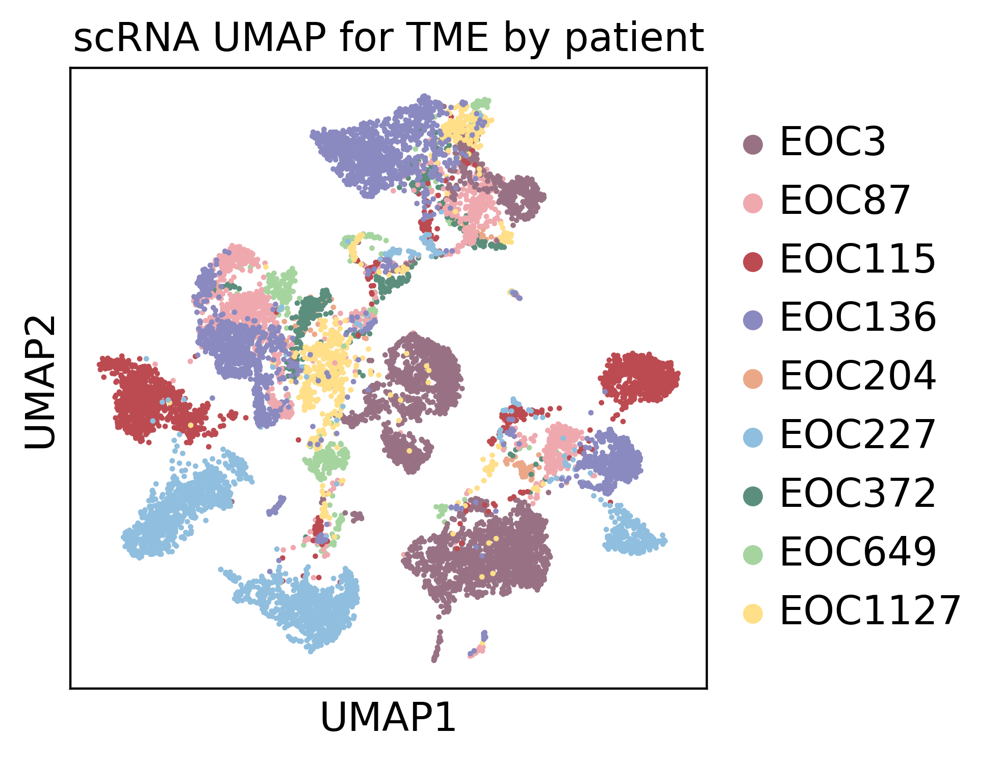

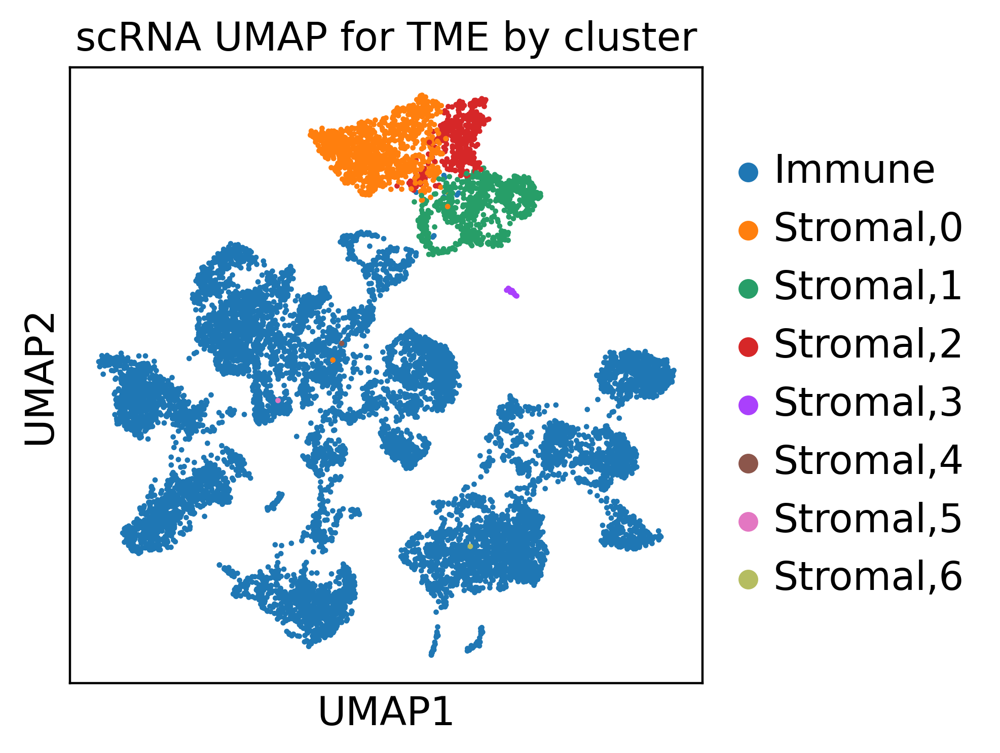

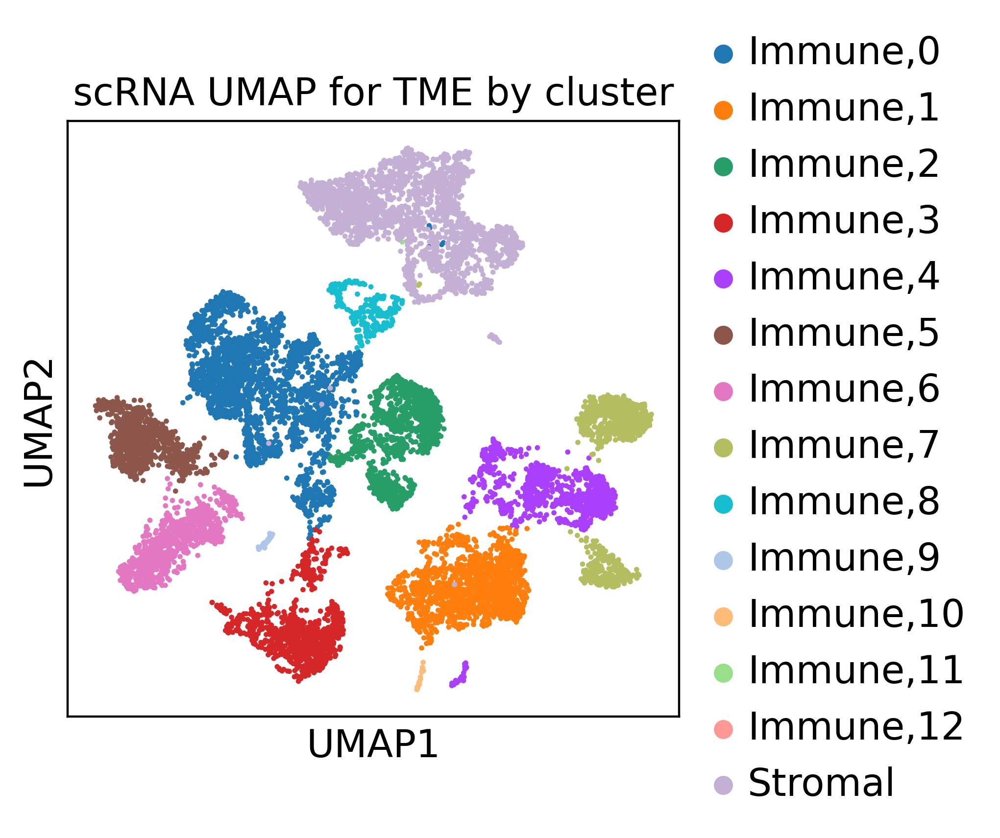

In [31]:
f1 = sc.pl.umap(adata_TME,
                color='patient_id',
                title='scRNA UMAP for TME by patient',
                frameon=True,
                legend_fontweight='normal',
                legend_fontsize=14,
                s=15,
                palette=patients_colors_EOC,
                return_fig=True)

f2 = sc.pl.umap(adata_TME,
                color='leiden_stromal',
                title='scRNA UMAP for TME by cluster',
                frameon=True,
                legend_fontweight='normal',
                legend_fontsize=14,
                s=15,
                return_fig=True)

f3 = sc.pl.umap(adata_TME,
                color='leiden_immune',
                title='scRNA UMAP for TME by cluster',
                frameon=True,
                legend_fontweight='normal',
                legend_fontsize=14,
                s=15,
                return_fig=True)

## Immune component

In [32]:
markers = dc.get_resource('PanglaoDB')
markers = markers[markers['human'] & markers['canonical_marker'] & (markers['human_sensitivity'] > 0.5)]
markers = markers[~markers.duplicated(['cell_type', 'genesymbol'])]
markers.head(5)

,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness
1,CTRB1,True,Acinar cells,Endoderm,True,1.000000,0.000629,True,0.957143,0.015920,9606,Pancreas,0.017
6,KLK1,True,Acinar cells,Endoderm,True,0.833333,0.005031,True,0.314286,0.012826,9606,Pancreas,0.013
14,PRSS3,True,Acinar cells,Endoderm,True,0.833333,0.028931,True,0.028571,0.000000,9606,Pancreas,0.006
15,CELA3A,True,Acinar cells,Endoderm,True,0.833333,0.000000,True,0.128571,0.000000,9606,Pancreas,0.001
17,PRSS1,True,Acinar cells,Endoderm,True,1.000000,0.005975,True,0.028571,0.000000,9606,Pancreas,0.002


In [33]:
immune_markers = markers[markers.cell_type.isin([
    # 'Endothelial cells',
    # 'Fibroblasts',
    'Macrophages',
    'Mast cells',
    'Dendritic cells',
    'B cells',
    'T cells',
    'NK cells',
    'Plasma cells',
    'Plasmacytoid dendritic cells',
])].reset_index(drop=True)

In [34]:
dc.run_ora(
    mat=adata_TME,
    net=immune_markers,
    source='cell_type',
    target='genesymbol',
    min_n=3,
    verbose=True,
    use_raw=False
)

8096 features of mat are empty, they will be removed.
Running ora on mat with 12205 samples and 33043 targets for 8 sources.


100%|████████████████████████████████████████████████████████████████| 12205/12205 [02:27<00:00, 82.65it/s]


In [35]:
acts = dc.get_acts(adata_TME, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

acts

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 12205 × 8
    obs: 'sample', 'patient_id', 'anatomical_location', 'cell_type', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'status', 'SBS3', 'cell_id', 'leiden_immune', 'leiden_stromal'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'patient_id_colors', 'leiden_stromal_colors', 'leiden_immune_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


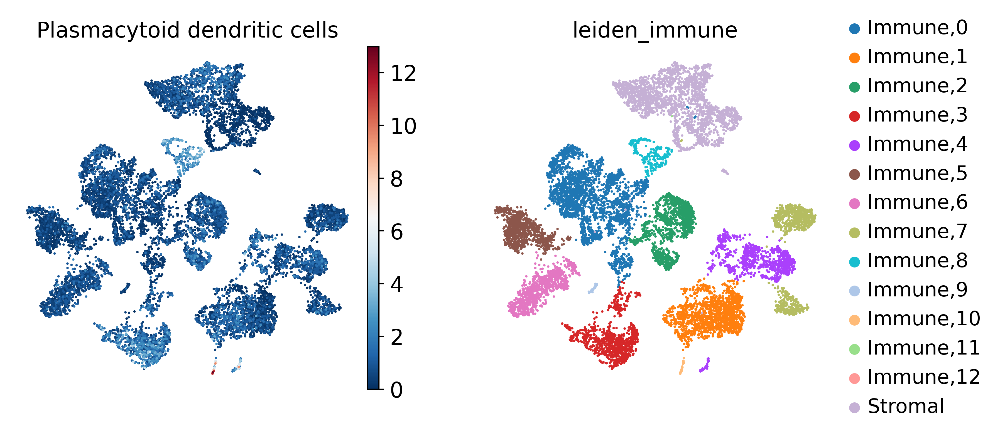

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


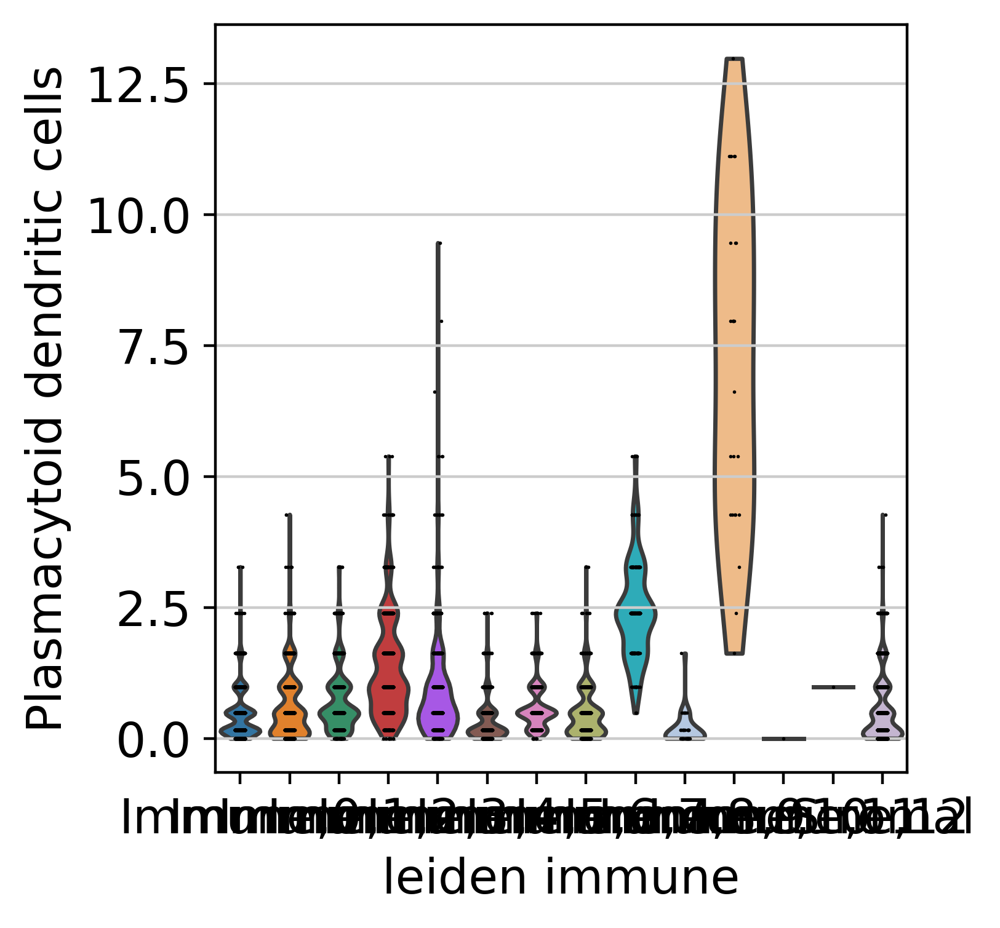

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


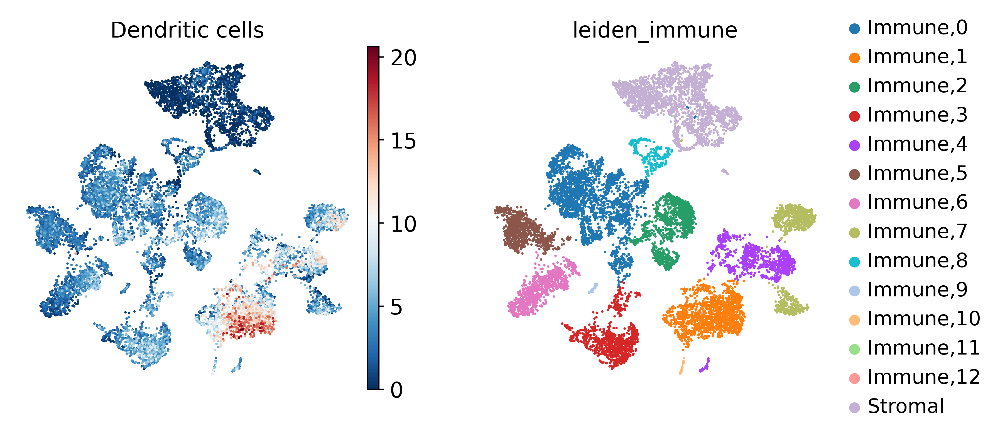

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


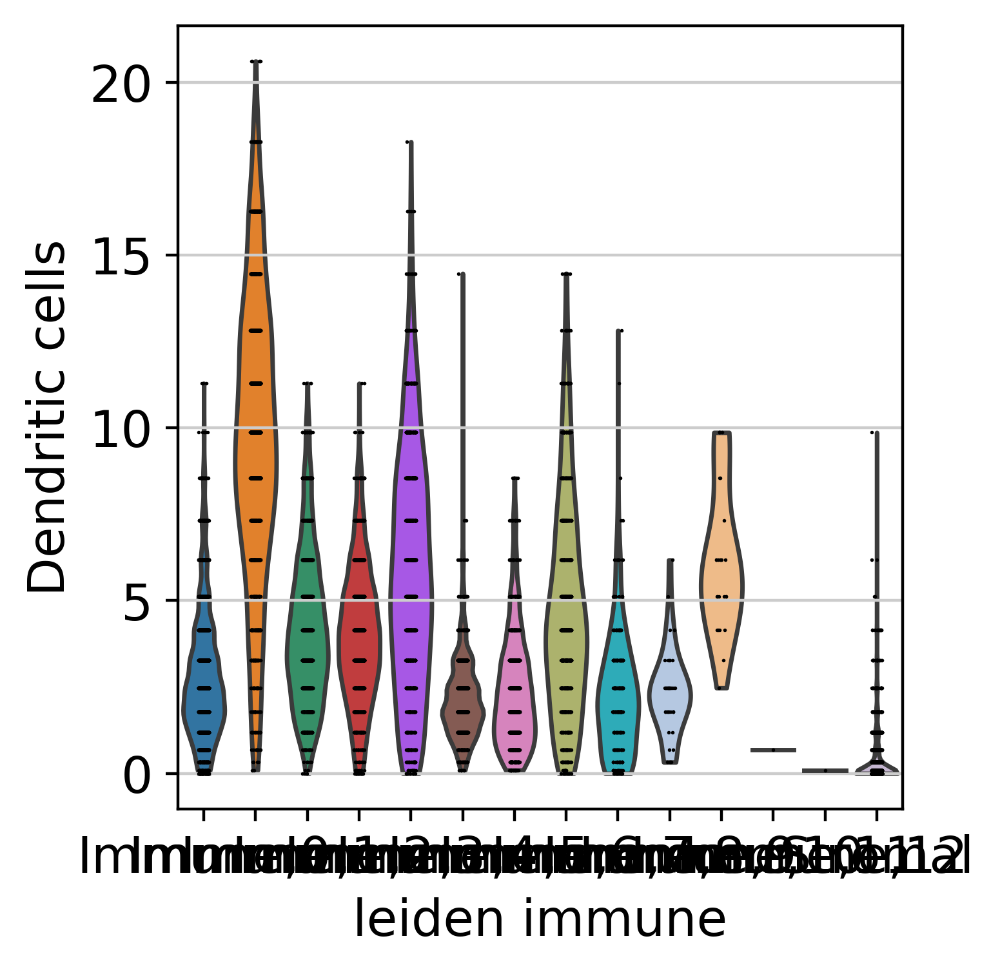

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


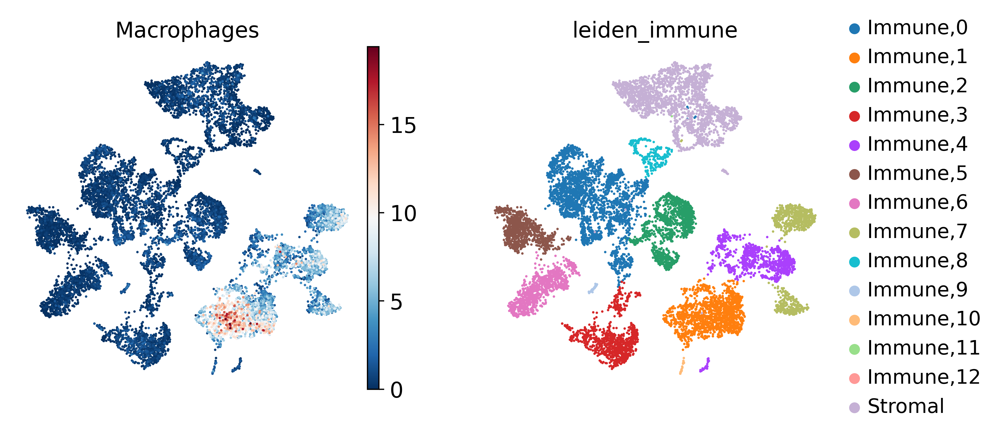

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


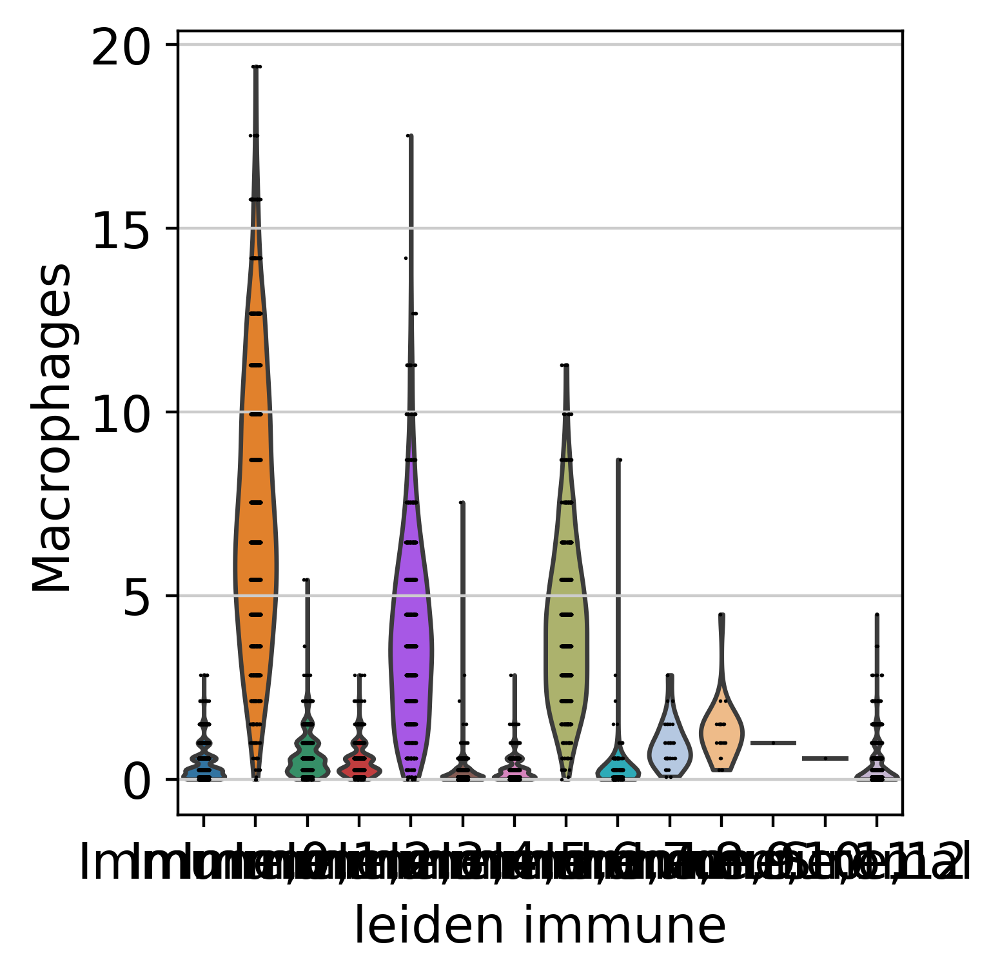

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


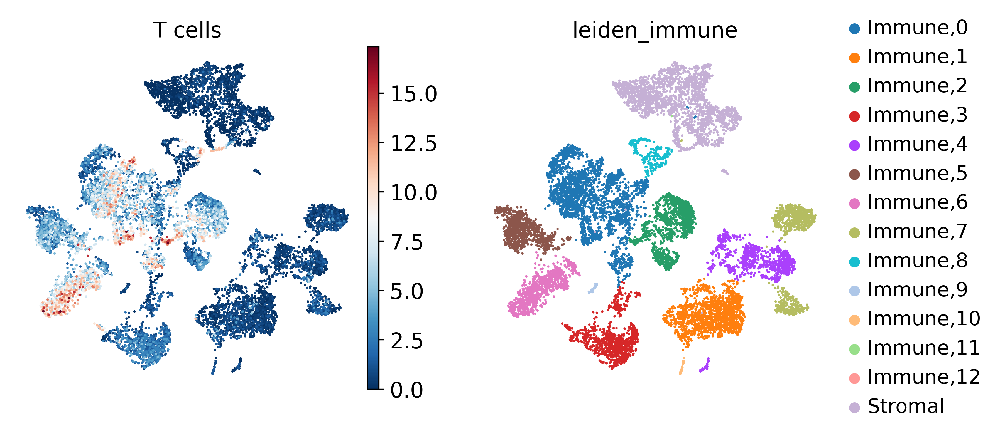

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


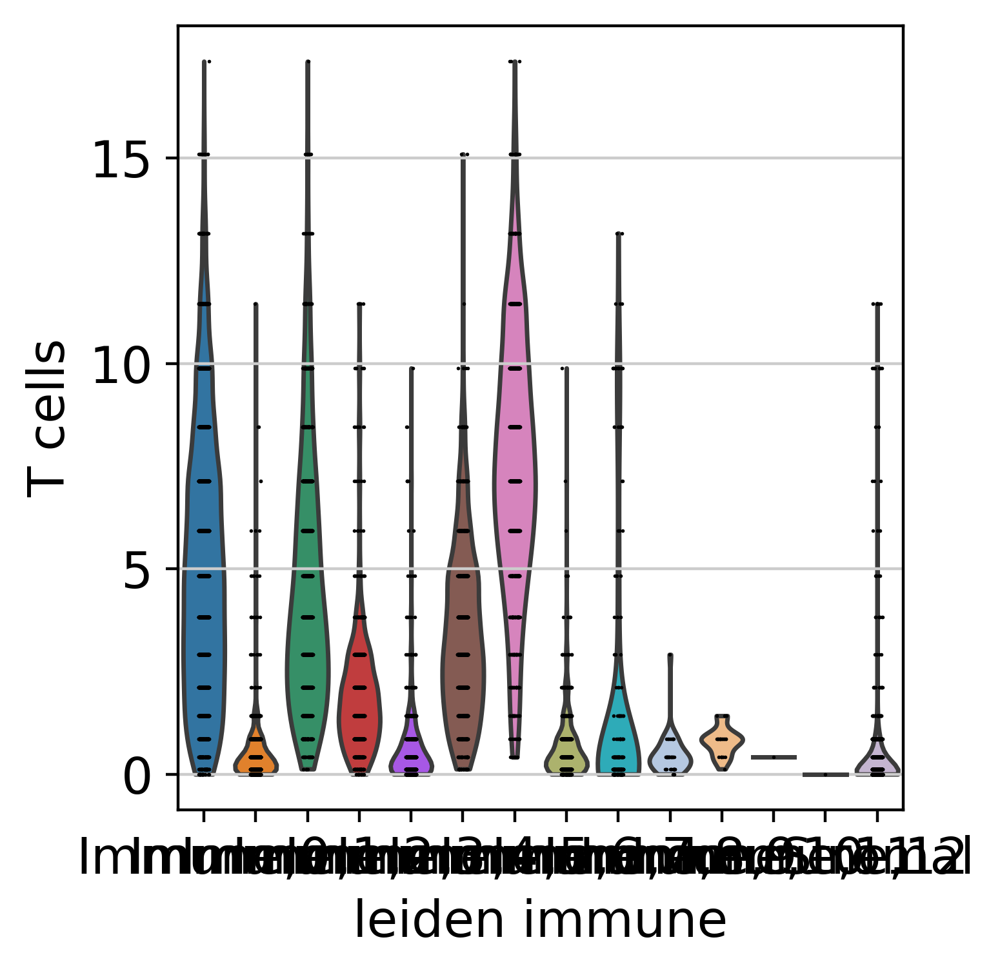

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


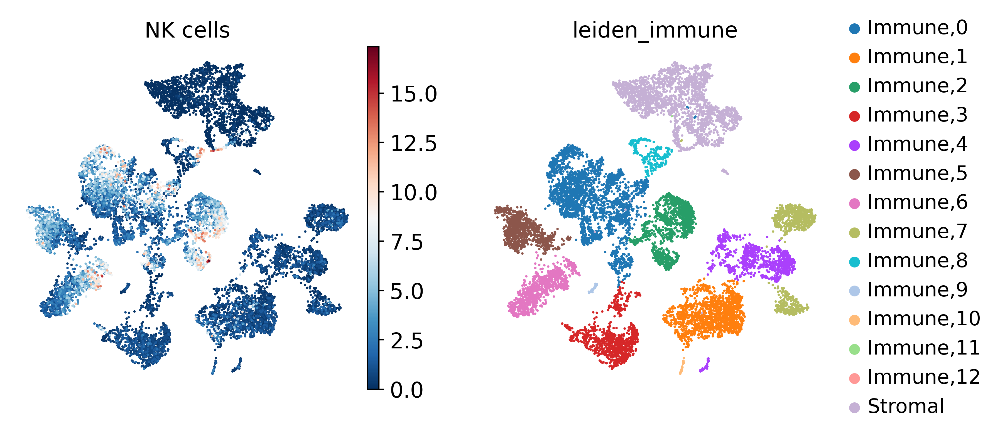

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


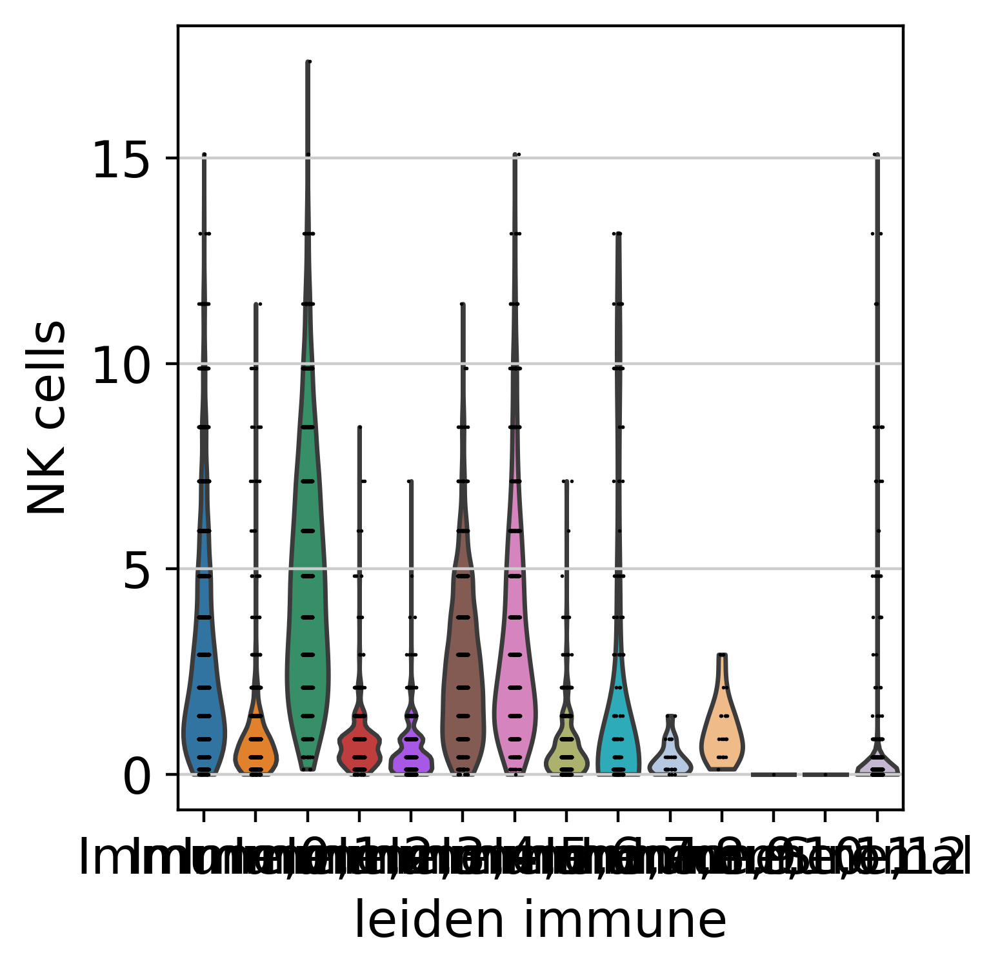

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


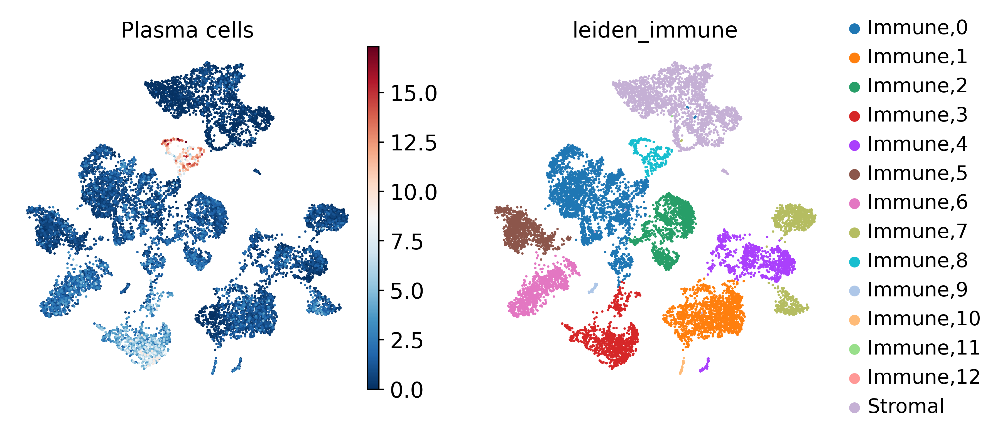

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


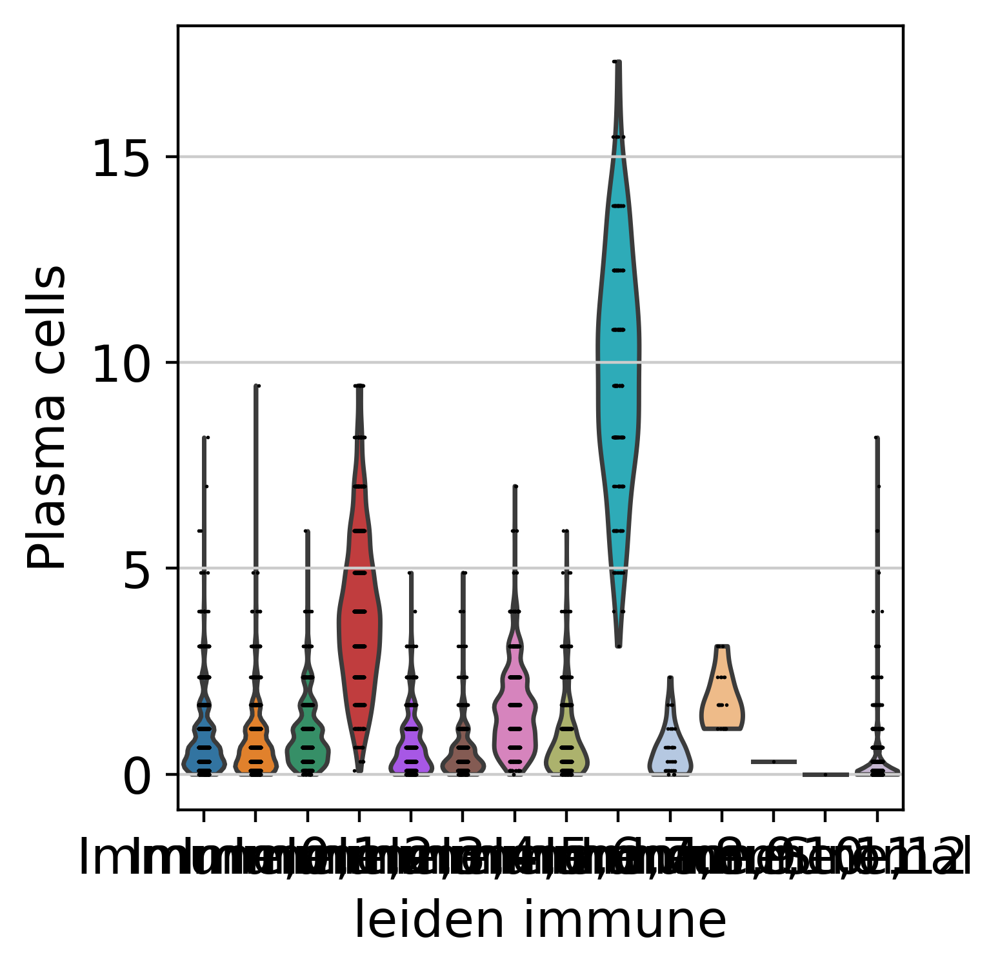

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


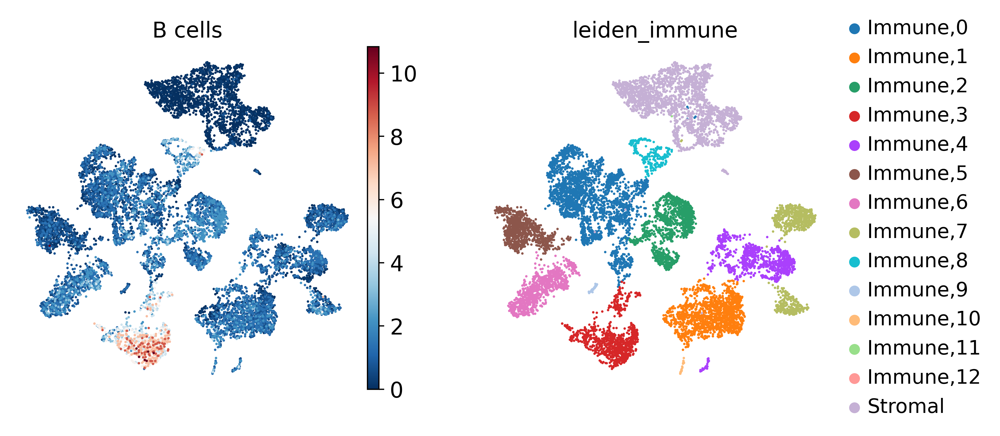

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


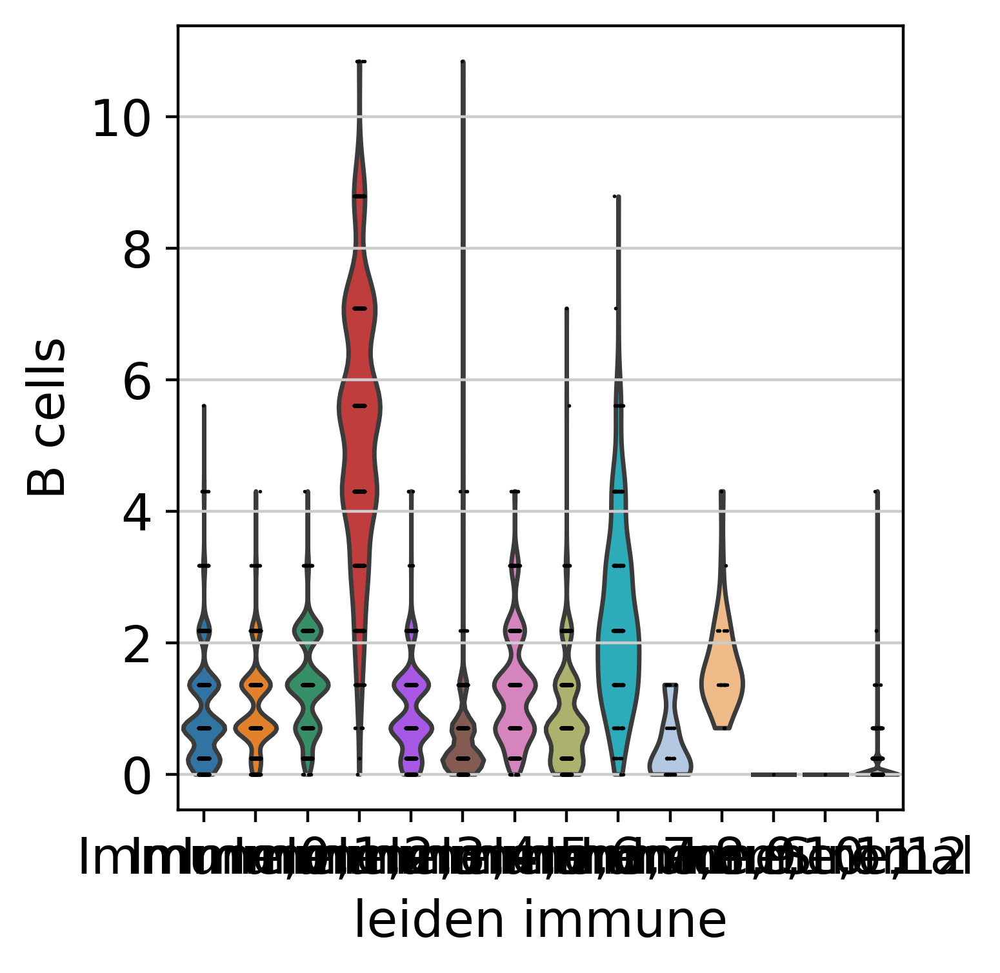

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


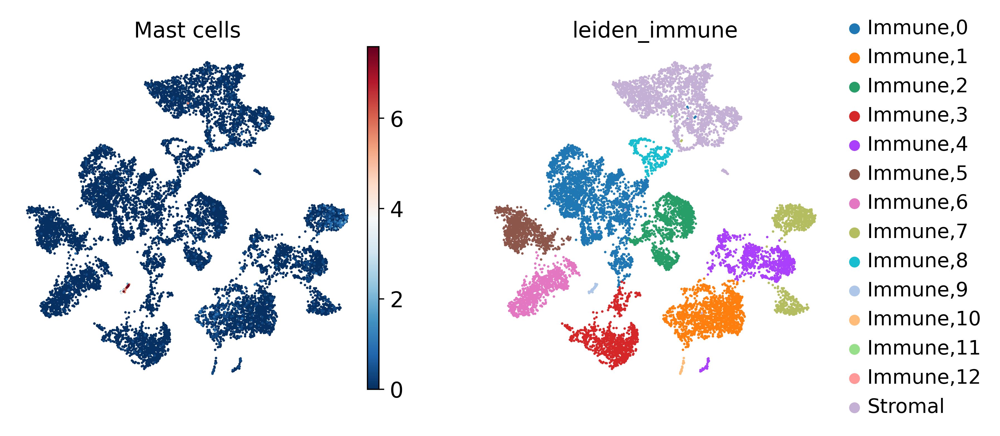

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


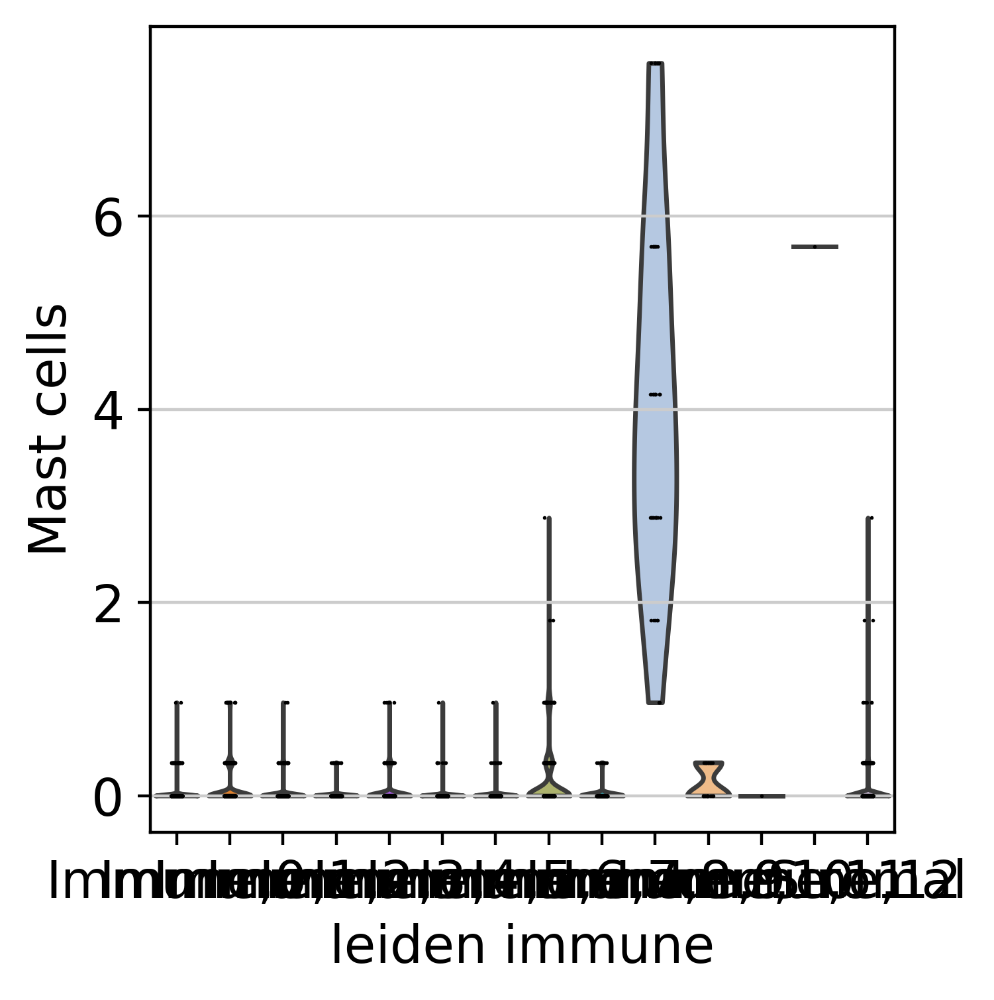

In [36]:
for cell_type in immune_markers.cell_type.unique():
    sc.pl.umap(acts,
               color=[cell_type, 'leiden_immune'],
               cmap='RdBu_r')
    sc.pl.violin(acts,
                 keys=[cell_type],
                 groupby='leiden_immune',)

In [37]:
df = dc.rank_sources_groups(acts, groupby='leiden_immune',
                            reference='rest', method='t-test_overestim_var')

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/numpy/core/_methods.py:265: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/numpy/core/_methods.py:257: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/numpy/core/_methods.py:265: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/numpy/core/_methods.py:257: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


In [38]:
n_ctypes = 2
ctypes_dict = df.groupby('group').head(n_ctypes).groupby('group')['names'].apply(lambda x: list(x)).to_dict()
ctypes_dict

{'Immune,0': ['T cells', 'NK cells'],
 'Immune,1': ['Macrophages', 'Dendritic cells'],
 'Immune,10': ['Plasmacytoid dendritic cells', 'Dendritic cells'],
 'Immune,11': ['Plasmacytoid dendritic cells', 'Dendritic cells'],
 'Immune,12': ['Plasmacytoid dendritic cells', 'Dendritic cells'],
 'Immune,2': ['NK cells', 'T cells'],
 'Immune,3': ['B cells', 'Plasma cells'],
 'Immune,4': ['Macrophages', 'Dendritic cells'],
 'Immune,5': ['NK cells', 'T cells'],
 'Immune,6': ['T cells', 'NK cells'],
 'Immune,7': ['Macrophages', 'Dendritic cells'],
 'Immune,8': ['Plasma cells', 'Plasmacytoid dendritic cells'],
 'Immune,9': ['Mast cells', 'Macrophages'],
 'Stromal': ['Mast cells', 'Plasmacytoid dendritic cells']}

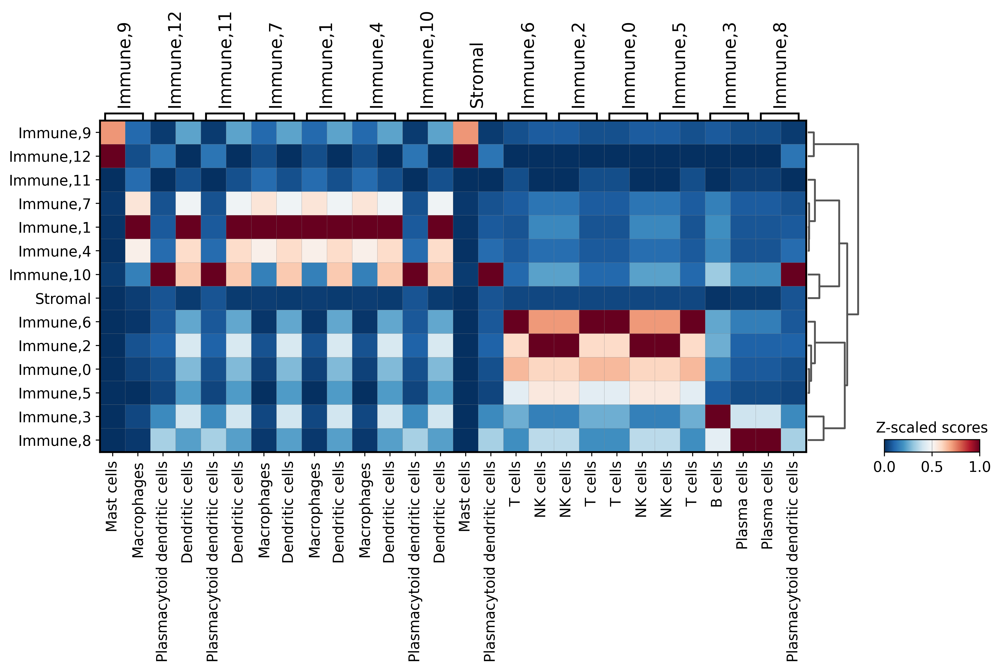

In [39]:
sc.pl.matrixplot(acts, ctypes_dict, 'leiden_immune', dendrogram=True, standard_scale='var',
                 colorbar_title='Z-scaled scores', cmap='RdBu_r')

In [40]:
annotation_dict = {
 'Immune,0': 'T cells',
 'Immune,1': 'Macrophages+DC',
 'Immune,10': 'pDC',
 'Immune,11': 'Macrophages+DC',
 'Immune,12': 'Mast cells',
 'Immune,2': 'NK cells',
 'Immune,3': 'B cells',
 'Immune,4': 'Macrophages+DC',
 'Immune,5': 'T cells',
 'Immune,6': 'T cells',
 'Immune,7': 'Macrophages+DC',
 'Immune,8': 'Plasma cells',
 'Immune,9': 'Mast cells',
 'Stromal': 'Stromal cells'
}

In [41]:
adata_TME.obs['cell_subtype_immune'] = [annotation_dict[clust] for clust in adata_TME.obs['leiden_immune']]

In [42]:
adata_TME.obs.groupby('cell_type').cell_subtype_immune.value_counts()

cell_type  cell_subtype_immune
Immune     T cells                4412
           Macrophages+DC         3178
           NK cells               1162
           B cells                 985
           Plasma cells            254
           Mast cells               45
           pDC                      26
Stromal    Stromal cells          2143
Name: cell_subtype_immune, dtype: int64

## Stromal component

In [43]:
stromal_markers = markers[markers.cell_type.isin([
    'Endothelial cells',
    'Fibroblasts',
    # 'Epithelial cells'
])].reset_index(drop=True)

In [44]:
dc.run_ora(
    mat=adata_TME,
    net=stromal_markers,
    source='cell_type',
    target='genesymbol',
    min_n=3,
    verbose=True,
    use_raw=False
)

8096 features of mat are empty, they will be removed.
Running ora on mat with 12205 samples and 33043 targets for 2 sources.


100%|████████████████████████████████████████████████████████████████| 12205/12205 [02:26<00:00, 83.21it/s]


In [45]:
acts = dc.get_acts(adata_TME, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

acts

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 12205 × 2
    obs: 'sample', 'patient_id', 'anatomical_location', 'cell_type', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'status', 'SBS3', 'cell_id', 'leiden_immune', 'leiden_stromal', 'cell_subtype_immune'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'patient_id_colors', 'leiden_stromal_colors', 'leiden_immune_colors', 'dendrogram_leiden_immune'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


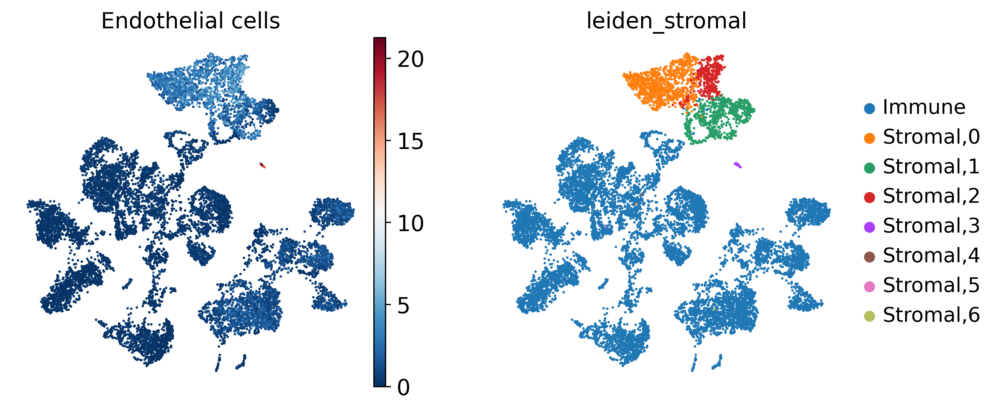

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


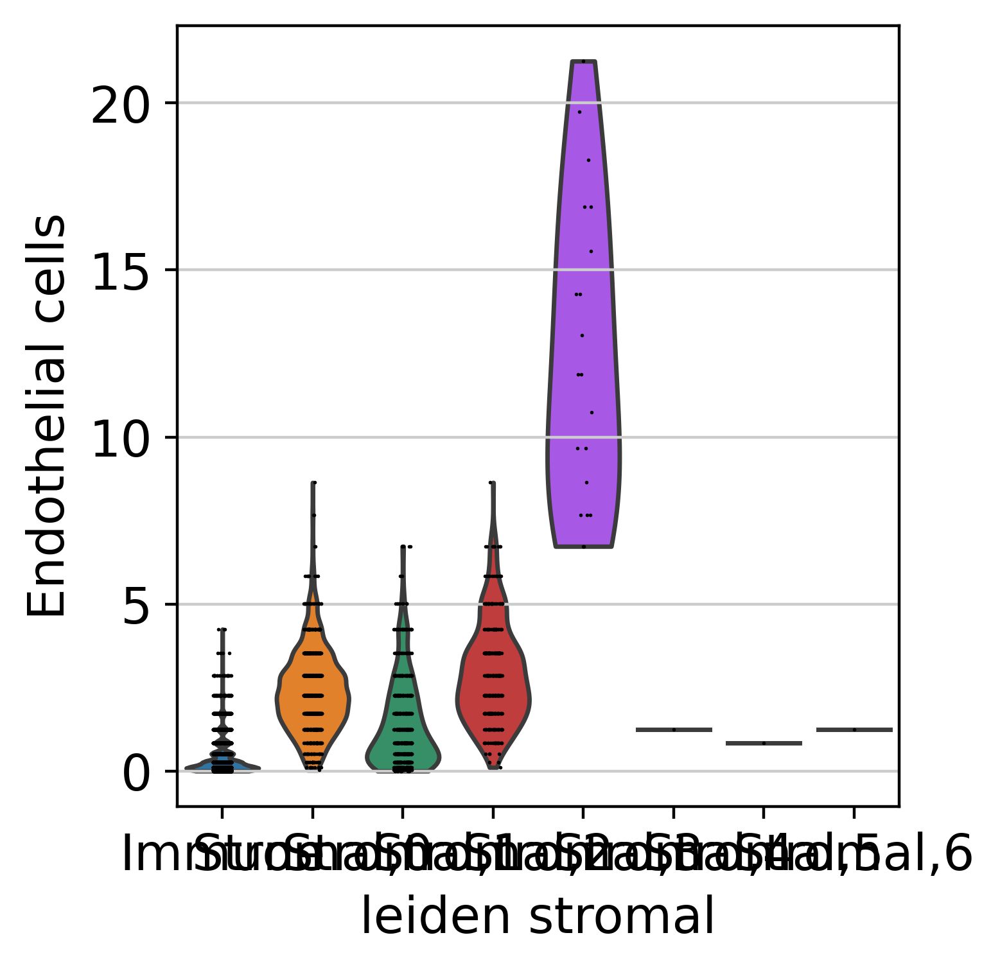

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


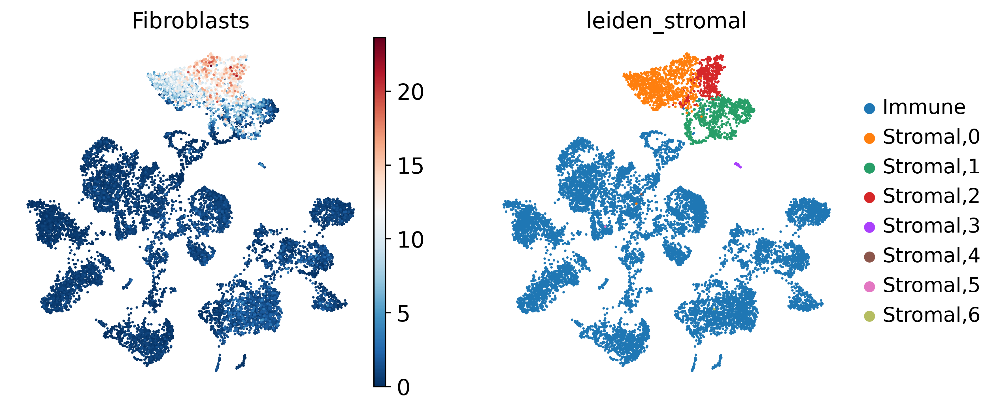

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


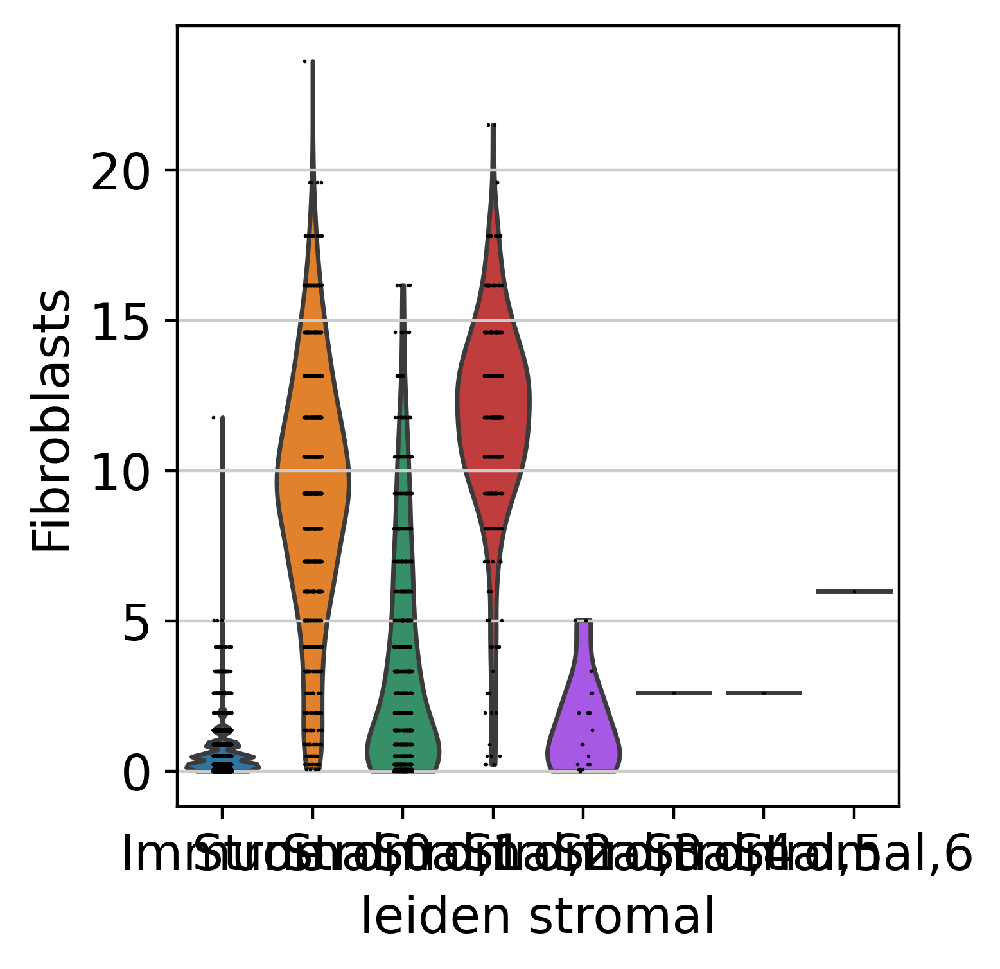

In [46]:
for cell_type in stromal_markers.cell_type.unique():
    sc.pl.umap(acts,
               color=[cell_type, 'leiden_stromal'],
               cmap='RdBu_r')
    sc.pl.violin(acts,
                 keys=[cell_type],
                 groupby='leiden_stromal',)

In [47]:
annotation_dict = {
 'Stromal,0': 'Fibroblasts',
 'Stromal,1': 'Fibroblasts',
 'Stromal,2': 'Fibroblasts',
 'Stromal,3': 'Endothelial cells',
 'Stromal,4': 'Fibroblasts',
 'Stromal,5': 'Fibroblasts',
 'Stromal,6': 'Fibroblasts',
 'Immune': 'Immune cells'
}

In [48]:
adata_TME.obs['cell_subtype_stromal'] = [annotation_dict[clust] for clust in adata_TME.obs['leiden_stromal']]

In [49]:
adata_TME.obs.groupby('cell_type').cell_subtype_stromal.value_counts()

cell_type  cell_subtype_stromal
Immune     Immune cells            10062
Stromal    Fibroblasts              2123
           Endothelial cells          20
Name: cell_subtype_stromal, dtype: int64

In [50]:
adata_TME.obs['cell_subtype'] = adata_TME.obs['cell_subtype_immune']
adata_TME.obs.loc[adata_TME.obs.cell_subtype == 'Stromal cells', 'cell_subtype'] =\
        adata_TME.obs.loc[adata_TME.obs.cell_subtype == 'Stromal cells', 'cell_subtype_stromal']

In [51]:
adata_TME.obs.cell_subtype.value_counts()

T cells              4412
Macrophages+DC       3178
Fibroblasts          2123
NK cells             1162
B cells               985
Plasma cells          254
Mast cells             45
pDC                    26
Endothelial cells      20
Name: cell_subtype, dtype: int64

## Markers check

In [26]:
# ann = pd.read_csv('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/full_adata_ann.tsv',
#             sep='\t', index_col=0)
# adata.obs['cell_subtype'] = ann['cell_subtype']
adata.obs['cell_subtype'] = 'EOC'
adata.obs.loc[adata_TME.obs.index, 'cell_subtype'] = adata_TME.obs['cell_subtype']

In [27]:
adata.obs.cell_subtype.value_counts()

EOC                  4577
T cells              4412
Macrophages+DC       3178
Fibroblasts          2123
NK cells             1162
B cells               985
Plasma cells          254
Mast cells             45
pDC                    26
Endothelial cells      20
Name: cell_subtype, dtype: int64

In [28]:
mrks = {
    'Housekeeping\ngenes': ['GAPDH', 'ACTB', 'B2M'],
    'EOC': ['EPCAM', 'CLDN4'],
    'Fibroblasts': ['COL3A1', 'NNMT'],
    'Endothelial cells': ['PECAM1', 'KDR'],
    'Immune': ['PTPRC'],
    'T+NK cells': ['CD3D', 'CD3E'],
    'NK cells': ['NKG7'],
    'B cells': ['MS4A1', 'CD79B'],
    'Plasma cells': ['MZB1', 'CD38'],
    'Macrophages+DC': ['CD14', 'CD163', 'FCGR3A'],
    'Mast cells': ['KIT', 'TPSAB1'],
    'pDC': ['PTGDS', 'IL3RA']
}

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


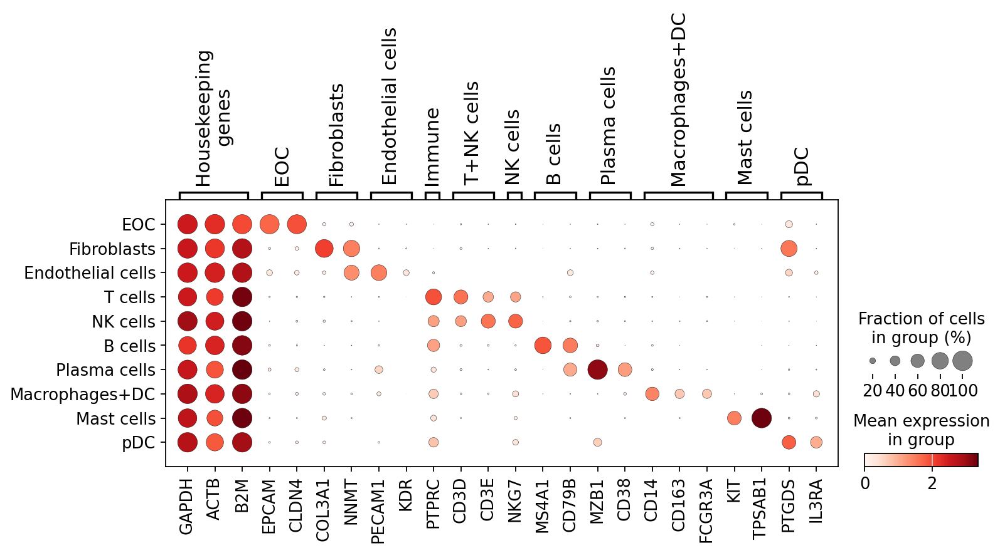

In [29]:
dp = sc.pl.dotplot(adata,
                   mrks,
                   'cell_subtype',
                   show=False, categories_order=['EOC', 'Fibroblasts', 'Endothelial cells',
                                                 'T cells', 'NK cells', 'B cells', 'Plasma cells',
                                                 'Macrophages+DC', 'Mast cells', 'pDC'],
                  )

ax = dp['mainplot_ax']
# plt.savefig('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/figures/markers_heatmap.pdf',
#             format='pdf', dpi=600, bbox_inches='tight')

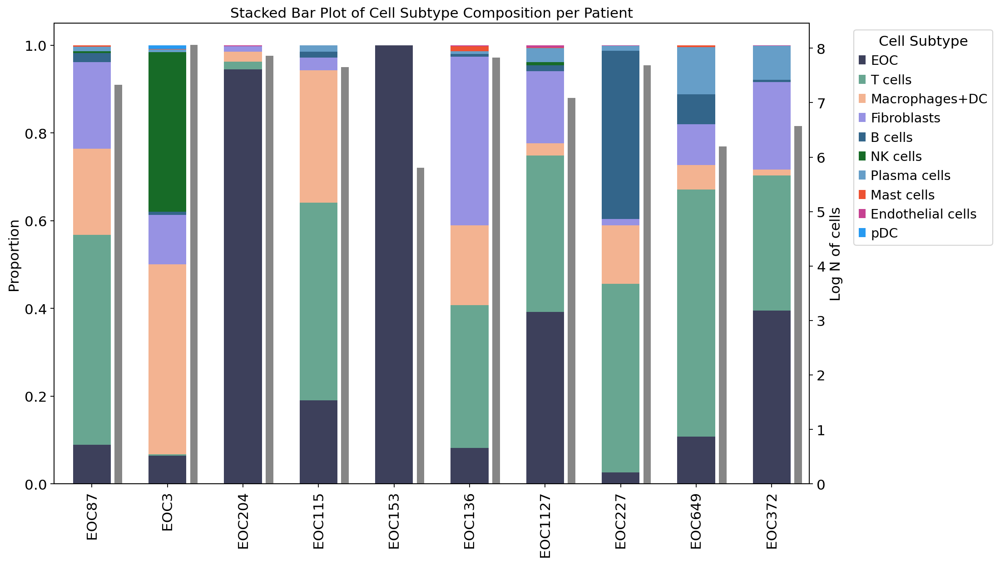

In [33]:
cell_subtype_counts = adata.obs.groupby(['patient_id', 'cell_subtype']).size().unstack(fill_value=0)
cell_subtype_counts = cell_subtype_counts.reindex(patients_ordered)
cell_subtype_proportions = cell_subtype_counts.div(cell_subtype_counts.sum(axis=1), axis=0)
sorted_df = cell_subtype_proportions[cell_subtype_proportions.mean().sort_values(ascending=False).index]


fig, ax = plt.subplots()

sorted_df.plot(kind='bar', stacked=True,
                              figsize=(14, 8),
                              color=[color_mapping[x] for x in sorted_df.columns],
                             ax=ax)

plt.title('Stacked Bar Plot of Cell Subtype Composition per Patient')
plt.ylabel('Proportion')
plt.xlabel('')
plt.legend(title='Cell Subtype', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=90)
plt.grid(False)
ax2 = ax.twinx()
counts=[np.log1p(x) for x in list(adata.obs.groupby(['patient_id']).size()\
    .loc[patients_ordered].values)]
ax2.bar([x + 0.35 for x in range(10)],
        counts, width=0.1, color='grey', alpha=0.95 )
ax2.set_ylabel('Log N of cells')
ax2.set_ylim(0, max(counts) + 0.4) 
plt.tight_layout()
plt.grid(False)

# plt.savefig('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/figures/TME_sample_composition.pdf',
#             format='pdf', dpi=600, bbox_inches='tight')

plt.show()

In [35]:
cell_subtype_proportions.mean(axis=0).sort_values()[::-1]

cell_subtype
EOC                  0.329131
T cells              0.293546
Macrophages+DC       0.136632
Fibroblasts          0.120519
B cells              0.051687
NK cells             0.037522
Plasma cells         0.026667
Mast cells           0.002304
Endothelial cells    0.001167
pDC                  0.000824
dtype: float64

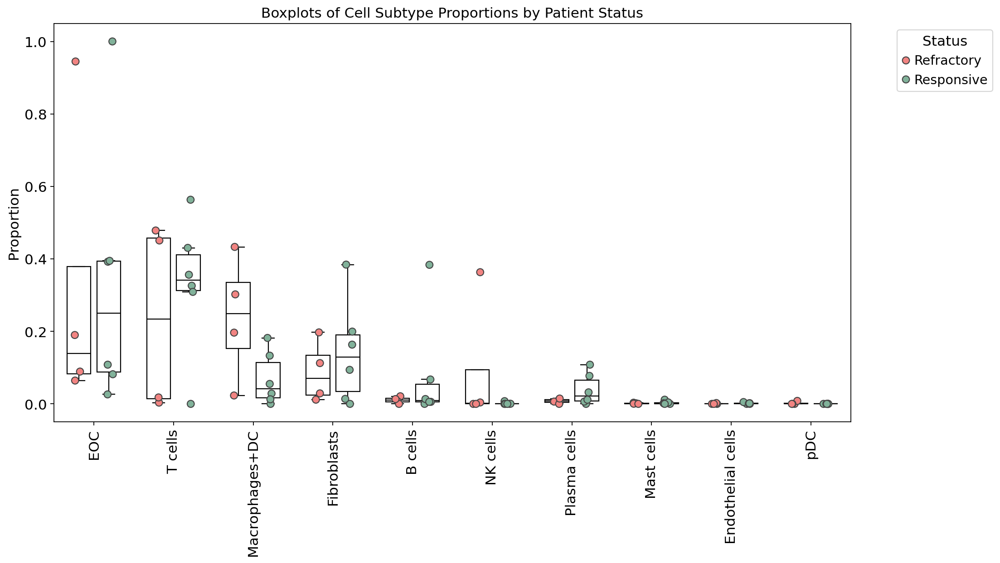

In [36]:
mean_proportions = cell_subtype_proportions.mean().sort_values(ascending=False)
cell_subtype_proportions = cell_subtype_proportions[mean_proportions.index]

melted_df = cell_subtype_proportions.reset_index().melt(id_vars=['patient_id'],
                                                        var_name='cell_subtype',
                                                        value_name='proportion')

merged_df = pd.merge(melted_df,
                     adata.obs[['patient_id', 'status']].drop_duplicates(),
                     on='patient_id')

p_values = {}

for subtype in merged_df['cell_subtype'].unique():

    responsive = merged_df[(merged_df['cell_subtype'] == subtype) &\
                           (merged_df['status'] == 'Responsive')]['proportion'].fillna(0)
    refractory = merged_df[(merged_df['cell_subtype'] == subtype) &\
                           (merged_df['status'] == 'Refractory')]['proportion'].fillna(0)
    
    t_stat, p_val = ttest_ind(responsive, refractory, equal_var=False)  # Use Welch's t-test
    p_values[subtype] = p_val

plt.figure(figsize=(14, 8))

sns.boxplot(x='cell_subtype',
            y='proportion',
            hue='status',
            data=merged_df,
            palette={'Refractory': 'white', 'Responsive': 'white'},
            showfliers=False, width=0.75, gap=0.2,
            linecolor='black', linewidth=1, legend=False)

sns.stripplot(x='cell_subtype',
              y='proportion',
              hue='status',
              data=merged_df, 
              dodge=True,
              jitter=True,
              marker='o',
              alpha=1.,
              palette=status_palette,
              size=7, linewidth=1)

handles, labels = plt.gca().get_legend_handles_labels()
l = plt.legend(handles[0:2], labels[0:2], title="Status", bbox_to_anchor=(1.05, 1), loc='upper left')

plt.title('Boxplots of Cell Subtype Proportions by Patient Status')
plt.ylabel('Proportion')
plt.xlabel('')
plt.legend(title='Status', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=90)

for subtype, p_val in p_values.items():
    if p_val < 0.05: 
        plt.text(
            x=merged_df['cell_subtype'].unique().tolist().index(subtype), 
            y=0.8, 
            s=f'p = {p_val:.3f}', 
            ha='center', 
            va='bottom', 
            color='red'
        )

plt.grid(False)
plt.tight_layout()

# plt.savefig('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/figures/TME_boxplots.pdf',
#             format='pdf', dpi=600, bbox_inches='tight')

plt.show()

# IFN across compartments

In [39]:
msigdb.head(3)

,genesymbol,collection,geneset
11,MSC,hallmark,HALLMARK_TNFA_SIGNALING_VIA_NFKB
149,ICOSLG,hallmark,HALLMARK_TNFA_SIGNALING_VIA_NFKB
223,ICOSLG,hallmark,HALLMARK_INFLAMMATORY_RESPONSE


In [40]:
dc.run_ora(
    mat=adata,
    net=msigdb,
    source='geneset',
    target='genesymbol',
    verbose=True
)

2698 features of mat are empty, they will be removed.
Running ora on mat with 16782 samples and 38441 targets for 50 sources.


100%|███████████████████████████████████████████████████████████████| 16782/16782 [02:36<00:00, 107.15it/s]


In [41]:
acts_msigdb = dc.get_acts(adata, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed
acts_msigdb_v = acts_msigdb.X.ravel()
max_e = np.nanmax(acts_msigdb_v[np.isfinite(acts_msigdb_v)])
acts_msigdb.X[~np.isfinite(acts_msigdb.X)] = max_e

acts_msigdb

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 16782 × 50
    obs: 'sample', 'patient_id', 'anatomical_location', 'cell_type', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'status', 'SBS3', 'cell_id', 'cell_subtype'
    uns: 'SBS3_colors', 'anatomical_location_colors', 'cell_type_colors', 'log1p', 'neighbors', 'patient_id_colors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'

In [42]:
acts_msigdb.obs['HALLMARK_INTERFERON_ALPHA_RESPONSE'] =\
acts_msigdb.obsm['ora_estimate']['HALLMARK_INTERFERON_ALPHA_RESPONSE']

In [43]:
acts_msigdb.obs = acts_msigdb.obs.rename(columns={'HALLMARK_INTERFERON_ALPHA_RESPONSE':
                                    'HALLMARK_IFN_ALPHA_RESPONSE'})

In [44]:
sc.set_figure_params(figsize=(10, 8), frameon=False,
                     dpi_save=600, vector_friendly=True)
sc.settings.n_jobs=2

/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


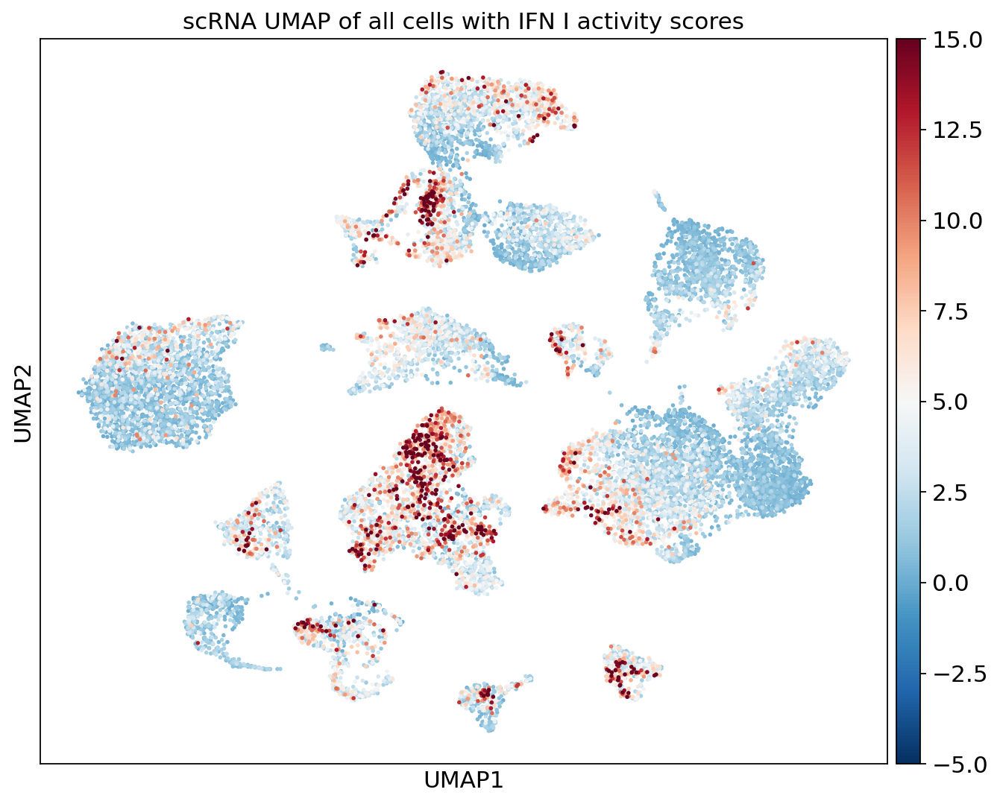

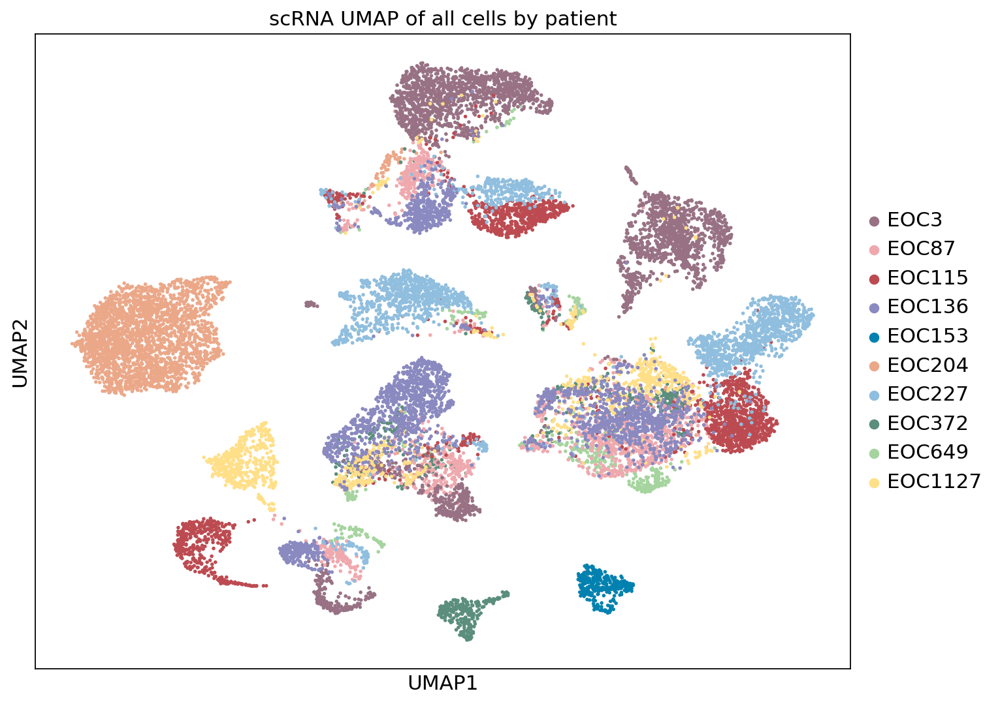

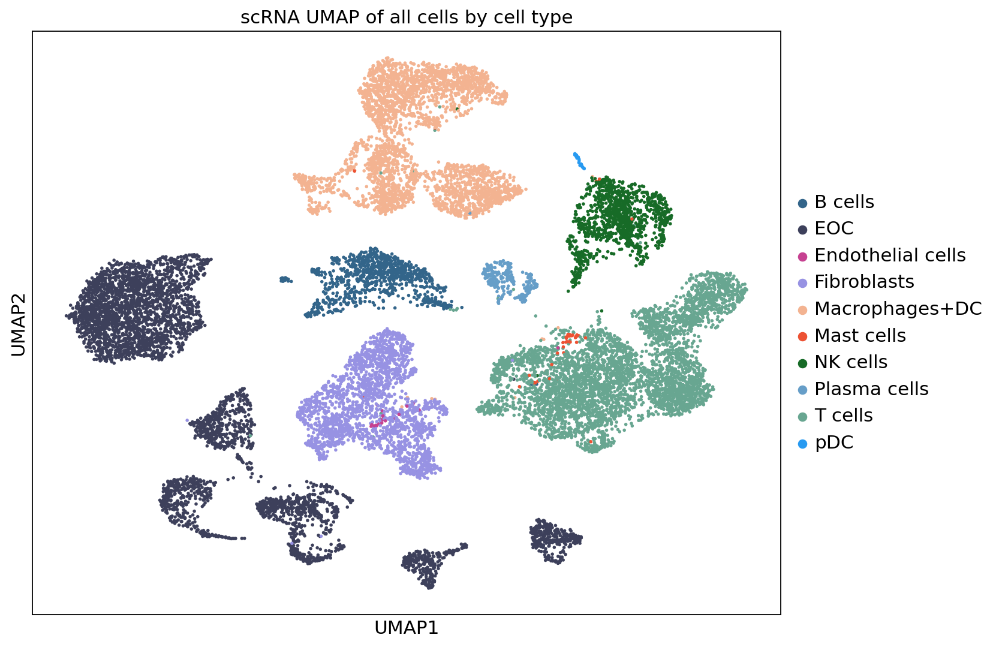

In [45]:
f1 = sc.pl.umap(acts_msigdb,
                color='HALLMARK_INTERFERON_ALPHA_RESPONSE',
                title='scRNA UMAP of all cells with IFN I activity scores',
                frameon=True,
                legend_fontweight='normal',
                cmap='RdBu_r',
                vmax=15, vmin=-5,
                legend_fontsize=6,
                s=25,
                return_fig=True)
# plt.savefig('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/figures/scRNA_UMAP_IFNa.pdf',
#             format='pdf', dpi=600, bbox_inches='tight')

f2 = sc.pl.umap(acts_msigdb,
                color='patient_id',
                title='scRNA UMAP of all cells by patient',
                frameon=True,
                legend_fontweight='normal',
                palette=patients_colors_EOC,
                legend_fontsize=14,
                s=25,
                return_fig=True)
# plt.savefig('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/figures/scRNA_UMAP_patient.pdf',
#             format='pdf', dpi=600, bbox_inches='tight')

f3 = sc.pl.umap(acts_msigdb,
                color='cell_subtype',
                title='scRNA UMAP of all cells by cell type',
                frameon=True,
                legend_fontweight='normal',
                palette=color_mapping,
                legend_fontsize=14,
                s=25,
                return_fig=True)
# plt.savefig('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/figures/scRNA_UMAP_celltype.pdf',
#             format='pdf', dpi=600, bbox_inches='tight')

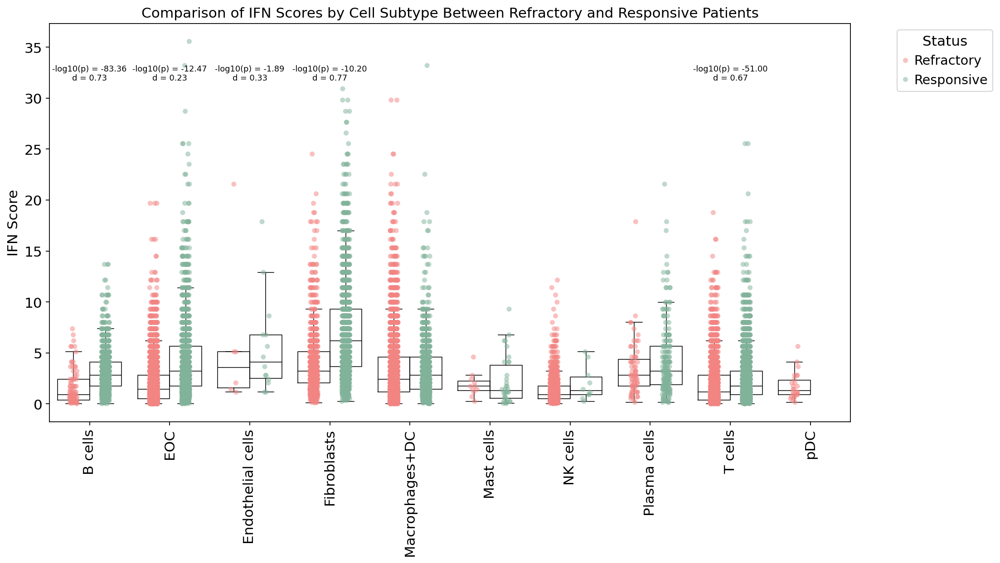

In [46]:
from numpy import log10

def cohen_d(x, y):
    if len(x) == 0 or len(y) == 0:
        return float('nan') 
    if x.std() == 0 or y.std() == 0:
        return float('nan') 
    return (x.mean() - y.mean()) / ((x.std() ** 2 + y.std() ** 2) / 2) ** 0.5

df = acts_msigdb.obs
p_values = {}
effect_sizes = {}

for subtype in df['cell_subtype'].unique():
    
    responsive = df[(df['cell_subtype'] == subtype) & (df['status'] == 'Responsive')]['HALLMARK_IFN_ALPHA_RESPONSE'].dropna()
    refractory = df[(df['cell_subtype'] == subtype) & (df['status'] == 'Refractory')]['HALLMARK_IFN_ALPHA_RESPONSE'].dropna()
    
    t_stat, p_val = ttest_ind(responsive, refractory, equal_var=False) 
    effect_size = cohen_d(responsive, refractory)
    
    p_values[subtype] = p_val
    effect_sizes[subtype] = effect_size

plt.figure(figsize=(14, 8))

sns.boxplot(x='cell_subtype', y='HALLMARK_IFN_ALPHA_RESPONSE',
            hue='status', data=df, showfliers=False, fill=False,
            palette={'Refractory': 'black', 'Responsive': 'black'},
            linewidth=0.7, legend=False)

sns.stripplot(x='cell_subtype', y='HALLMARK_IFN_ALPHA_RESPONSE', hue='status', data=df, 
              dodge=True, jitter=True, marker='o', alpha=0.5, palette=status_palette, legend=True)

handles, labels = plt.gca().get_legend_handles_labels()
l = plt.legend(handles[0:2], labels[0:2], title="Status", bbox_to_anchor=(1.05, 1), loc='upper left')

plt.title('Comparison of IFN Scores by Cell Subtype Between Refractory and Responsive Patients')
plt.ylabel('IFN Score')
plt.xlabel('')
plt.xticks(rotation=90)

for subtype, p_val in p_values.items():
    if p_val < 0.05: 
        effect_size = effect_sizes[subtype]
        plt.text(
            x=df['cell_subtype'].unique().tolist().index(subtype), 
            y=max(df['HALLMARK_IFN_ALPHA_RESPONSE']) - 4, 
            s=f'-log10(p) = {log10(p_val):.2f}\nd = {effect_size:.2f}', 
            ha='center', 
            va='bottom', 
            color='black', 
            size=8
        )
        
plt.grid(False)
plt.tight_layout()

# Show the plot
plt.show()

/tmp/ipykernel_412612/1301466991.py:23: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  t_stat, p_val = ttest_ind(responsive, refractory, equal_var=False)  # Welch's t-test
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scipy/stats/_stats_py.py:1214: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
/mnt/csc-gc8/work/afenteva/virtualenvs/jupyter/lib/python3.8/site-packages/scipy/stats/_stats_py.py:1214: RuntimeWarning: invalid value encountered in double_scalars
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


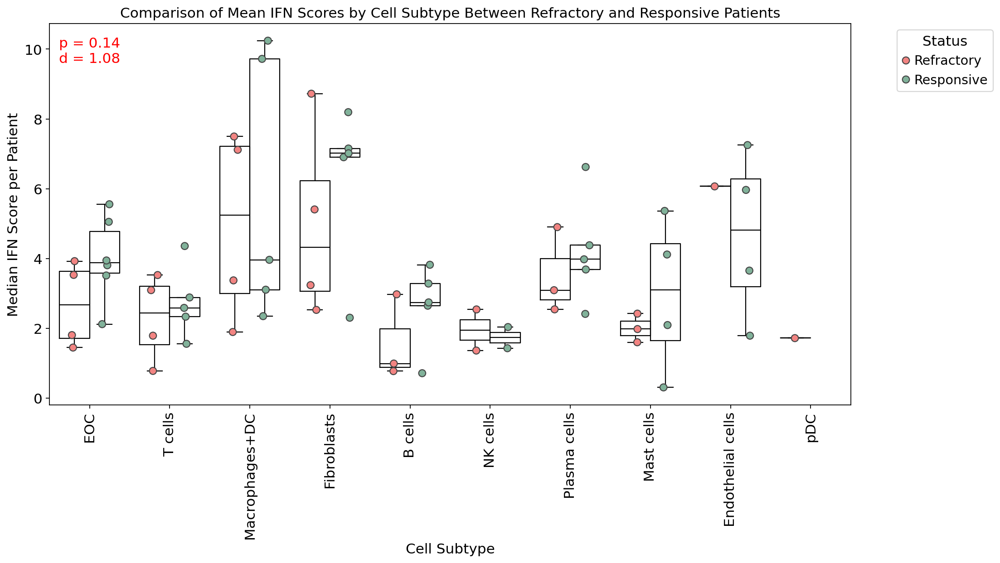

In [53]:
cell_type_order = [
    'EOC', 'T cells', 'Macrophages+DC', 'Fibroblasts', 
    'B cells', 'NK cells', 'Plasma cells', 'Mast cells', 
    'Endothelial cells', 'pDC'
]

median_ifn_scores = df.groupby(['patient_id', 'cell_subtype', 'status'])['HALLMARK_IFN_ALPHA_RESPONSE'].mean().reset_index()

p_values = {}
effect_sizes = {}

for subtype in median_ifn_scores['cell_subtype'].unique():
    responsive = median_ifn_scores[
        (median_ifn_scores['cell_subtype'] == subtype) & 
        (median_ifn_scores['status'] == 'Responsive')
    ]['HALLMARK_IFN_ALPHA_RESPONSE'].dropna()

    refractory = median_ifn_scores[
        (median_ifn_scores['cell_subtype'] == subtype) & 
        (median_ifn_scores['status'] == 'Refractory')
    ]['HALLMARK_IFN_ALPHA_RESPONSE'].dropna()

    t_stat, p_val = ttest_ind(responsive, refractory, equal_var=False)  # Welch's t-test
    effect_size = cohen_d(responsive, refractory)
    
    p_values[subtype] = p_val
    effect_sizes[subtype] = effect_size

plt.figure(figsize=(14, 8))

sns.boxplot(x='cell_subtype', y='HALLMARK_IFN_ALPHA_RESPONSE',
            hue='status', data=median_ifn_scores,
            legend=False,
            showfliers=False, fill=False, order=cell_type_order,
            palette={'Refractory': 'black', 'Responsive': 'black'},
            width=0.75, linewidth=1)

sns.stripplot(x='cell_subtype', y='HALLMARK_IFN_ALPHA_RESPONSE', 
              hue='status', data=median_ifn_scores, 
              dodge=True, jitter=True, marker='o',
              alpha=1.0, palette=status_palette, size=7, linewidth=1, 
              order=cell_type_order)

handles, labels = plt.gca().get_legend_handles_labels()
l = plt.legend(handles[0:2], labels[0:2], title="Status", bbox_to_anchor=(1.05, 1), loc='upper left')

plt.title('Comparison of Mean IFN Scores by Cell Subtype Between Refractory and Responsive Patients')
plt.ylabel('Mean IFN Score per Patient')
plt.xlabel('Cell Subtype')
plt.xticks(rotation=90)

for subtype, p_val in p_values.items():
    if p_val < 0.15 and not pd.isna(effect_sizes[subtype]):
        effect_size = effect_sizes[subtype]
        plt.text(
            x=cell_type_order.index(subtype), 
            y=max(median_ifn_scores['HALLMARK_IFN_ALPHA_RESPONSE']) - 0.7, 
            s=f'p = {p_val:.2f}\nd = {effect_size:.2f}', 
            ha='center', va='bottom', color='red'
        )

plt.grid(False)
plt.tight_layout()

# plt.savefig('/mnt/storageBig8/work/afenteva/ChemoRef/REVIEW1/scRNA/figures/boxplots_IFNa_x_celltypes.pdf',
#             format='pdf', dpi=600, bbox_inches='tight')

plt.show()